In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

In [ ]:
!cd '/content/gdrive/My Drive/Object_Detection_Transformers/main-repo/'

In [ ]:
import numpy as np
import os

from tensorflow import keras
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import cv2


In [ ]:
def bbox_iou(bbox_a, bbox_b):
    """Calculate the Intersection of Unions (IoUs) between bounding boxes.

    IoU is calculated as a ratio of area of the intersection
    and area of the union.

    both inputs and output should be python list
    """
    ##########--WRITE YOUR CODE HERE--##########

    a = np.array(bbox_a)
    b = np.array(bbox_b)
    a = a.repeat(b.shape[0], axis = 0)

    top_left_a = a[ : , [0,1]] 
    if(b.shape[0] == 0):
      return [[0]]
    top_left_b = b[ : , [0,1]]
    bottom_right_a = a[ : , [2,3]] 
    bottom_right_b = b[ : , [2,3]]
    max_pts = np.maximum(top_left_a , top_left_b)
    min_pts = np.minimum(bottom_right_a , bottom_right_b)

    inter_pts = np.concatenate((max_pts , min_pts) , axis = 1)

    inter_dim = np.stack( [inter_pts[: , 2] -  inter_pts[: , 0] , inter_pts[: , 3] -  inter_pts[: , 1] ] , axis = 0).T
    inter_dim[inter_dim < 0] = 0 
    inter = np.multiply( inter_dim[:, 0] , inter_dim[:,1])

    gt_area = (bbox_a[0][2] - bbox_a[0][0]) * (bbox_a[0][3] - bbox_a[0][1])

    bbox_b_dim = np.stack( [b[: , 2] -  b[: , 0] , b[: , 3] -  b[: , 1] ] , axis = 0).T
    bbox_b_areas = np.multiply( bbox_b_dim[:, 0] , bbox_b_dim[:,1])

    union = bbox_b_areas - inter + gt_area

    iou = [( inter / union ).tolist()]



    ##########-------END OF CODE-------########## 
    return iou


In [ ]:
def get_unique_boxes(boxes):

  if(boxes == []):
    return []

  boxes_unique = [boxes.pop()]

  for box in boxes:
    iou = bbox_iou([box] , boxes_unique)[0]
    drop = False
    for val in iou:
      if(val > 0.60):
        drop = True
        break
    if(not drop):
      boxes_unique.append(box)
          
  return boxes_unique




In [ ]:
def calculate_iou(gt , pred):
  total = 0
  count = 0
  for box in gt:
    iou = bbox_iou([box], pred)[0]
    max_iou = max(iou)
    idx = iou.index(max_iou)
    if(pred == []):
      break
    pred.pop(idx)
    total = total + max_iou
    count = count + 1
  return total/count



elkhorn-1-14-57_jpg.rf.2d1fd26f5c2ec841f2330d9b71c88026.jpg


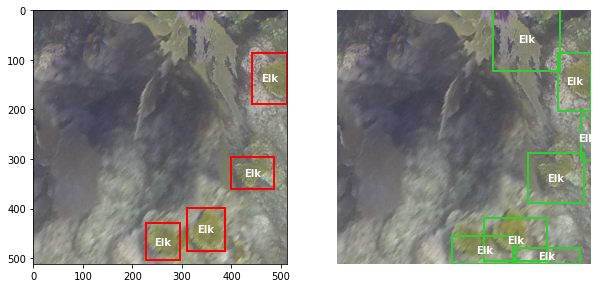

iou  =  0.515739338757593
elkhorn-1-21-41_jpg.rf.22233e24134f4fe3178f0c9fb1423eff.jpg


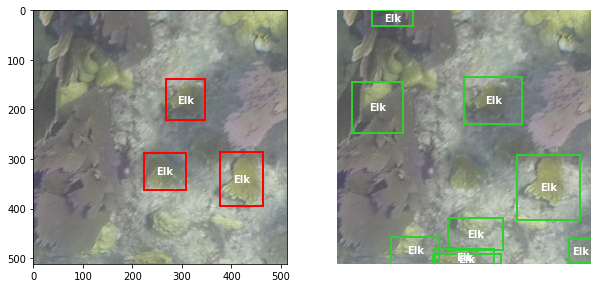

iou  =  0.37386786234051944
elkhorn-1-21-48_jpg.rf.d82dec2b167178d5b201e942bad40007.jpg


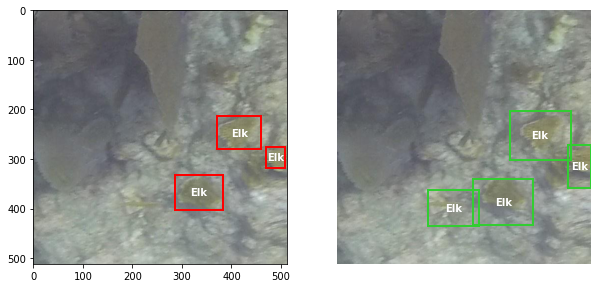

iou  =  0.4584393280159435
elkhorn-1-23-30_jpg.rf.d501700fed8fbbbb0db5d84d6d406075.jpg


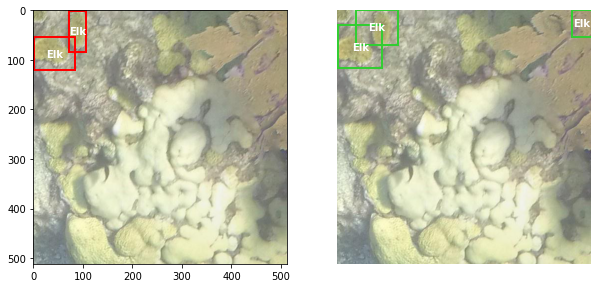

iou  =  0.5027518253554542
elkhorn-1-24-38_jpg.rf.0675bb5e5d1ebe5acdeec9480f975cf4.jpg


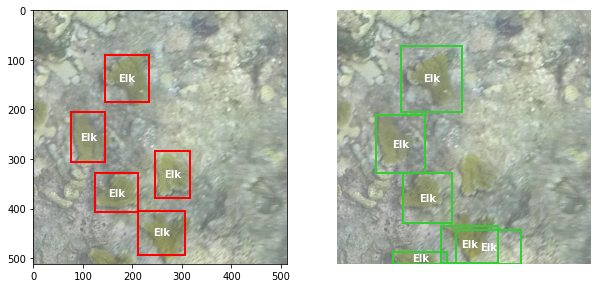

iou  =  0.42279188556319636
elkhorn-1-26-36_jpg.rf.a30d01b2817f81d0cc58a5d2cb9d461e.jpg


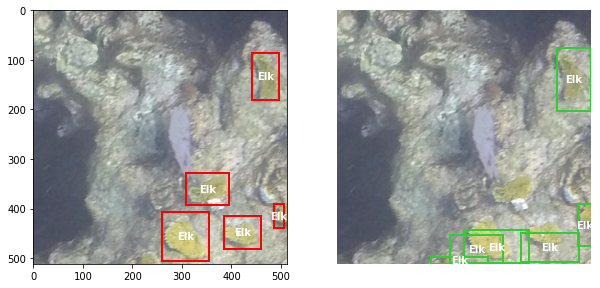

iou  =  0.3482971808897677
elkhorn-1-27-36_jpg.rf.6f0b7a2062731734adc561cde0469329.jpg


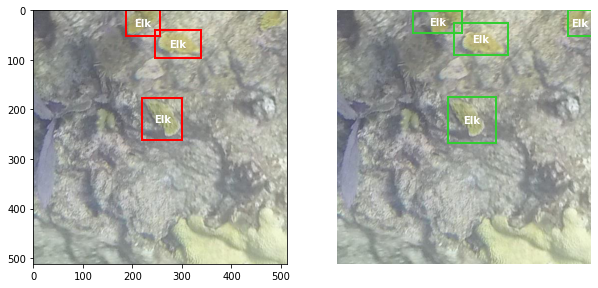

iou  =  0.6440232935428774
elkhorn-1-28-41_jpg.rf.fc0ddf68a9f71b59637da7a8c3459b29.jpg


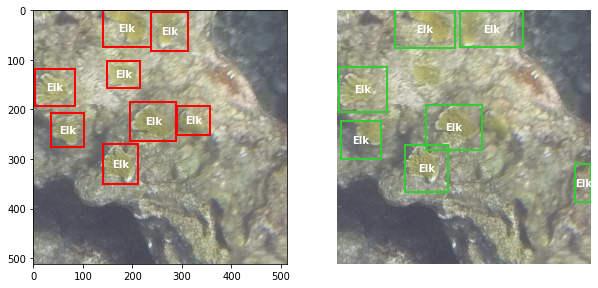

iou  =  0.09637815096014393
elkhorn-1-29-24_jpg.rf.4782a3bd59a82c1ae0af025eaeb886bb.jpg


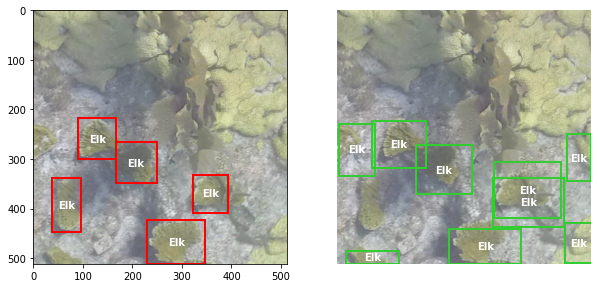

iou  =  0.42525651076163495
elkhorn-1-30-20_jpg.rf.0c522143198659c9780f87cfa3897539.jpg


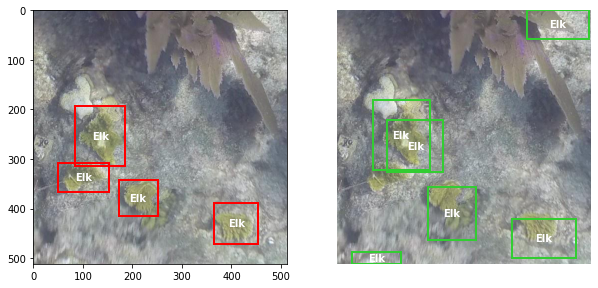

iou  =  0.37195012405020383
elkhorn-1-30-24_jpg.rf.4a9ec4d27341e37cea47548bd343adf0.jpg


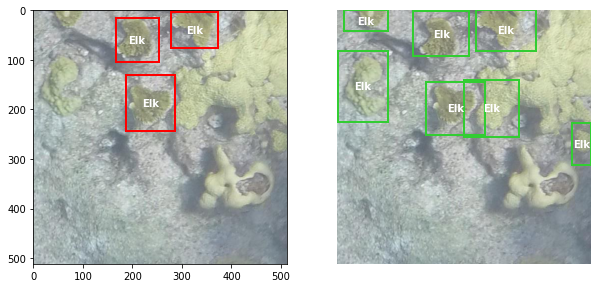

iou  =  0.6514547355904046
elkhorn-1-31-18_jpg.rf.310576d21f698c92042ab7c6355b2722.jpg


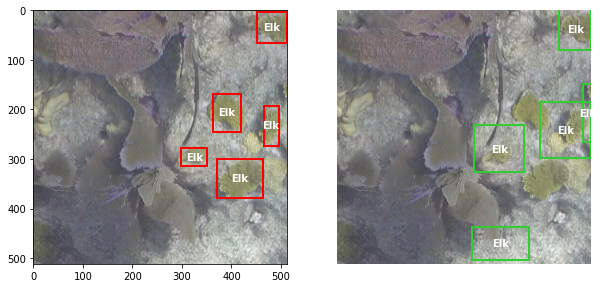

iou  =  0.05052732108280118
elkhorn-1-31-25_jpg.rf.51853e44069267899cc3f771ec9e35b8.jpg


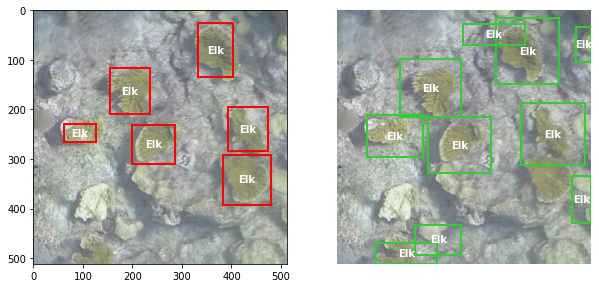

iou  =  0.36469521291498525
elkhorn-1-32-19_jpg.rf.423d9dac91a93e82ea870accc714f9c2.jpg


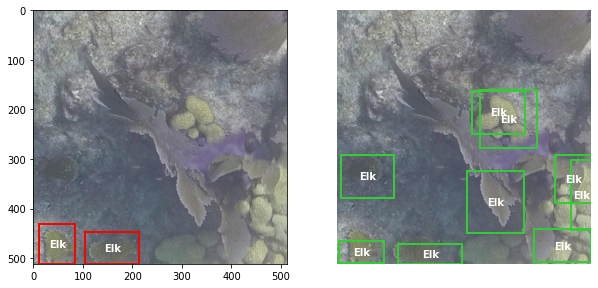

iou  =  0.4649004467462211
elkhorn-1-34-13_jpg.rf.b0614134f46156b29f56d90b2b2ffe1a.jpg


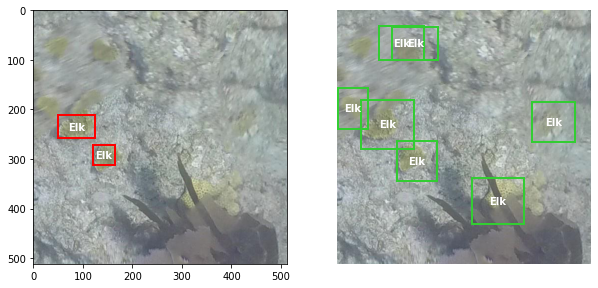

iou  =  0.31477932218556215
elkhorn-1-35-24_jpg.rf.939cfa95983da607badcc1af64491204.jpg


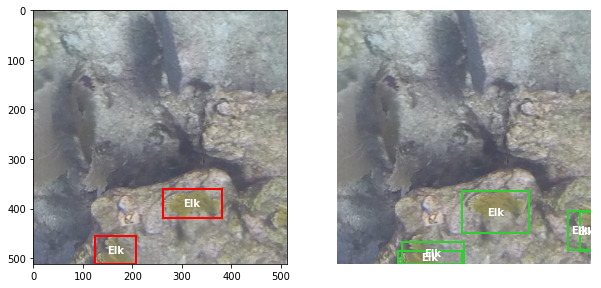

iou  =  0.5314408339801072
elkhorn-1-40-13_jpg.rf.1f12b7fe9fc33219ed079367bd7a8d75.jpg


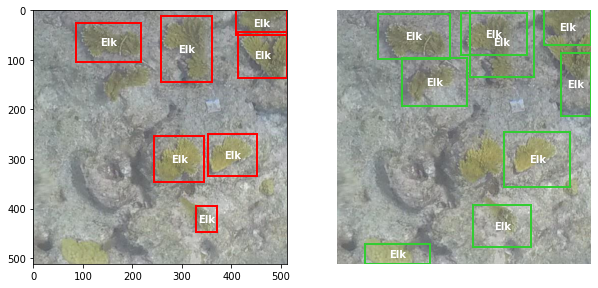

iou  =  0.4178456180669955
elkhorn-1-42-17_jpg.rf.404795d8f5ed0a466d97941dcc16efcd.jpg


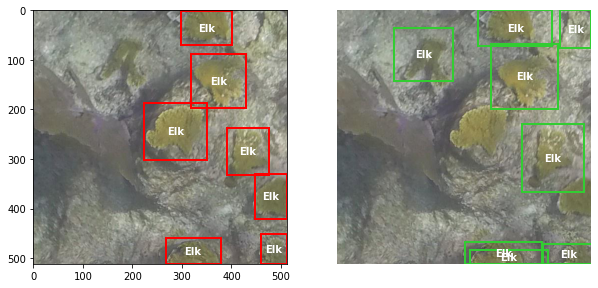

iou  =  0.3166653164407558
elkhorn-1-42-9_jpg.rf.c416972ad2cf82fcf9610bcf9651805c.jpg


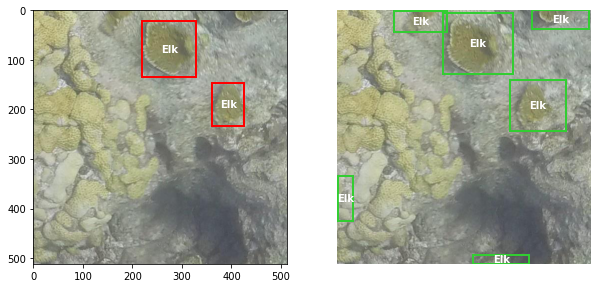

iou  =  0.5668369856542186
elkhorn-1-44-8_jpg.rf.15fa526fc7f06d498ec704dfcfbbfc66.jpg


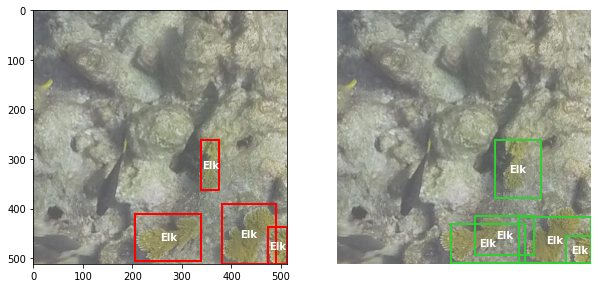

iou  =  0.5081103641520541
elkhorn-1-45-9_jpg.rf.05973b607867f64a1819f05b5e668c30.jpg


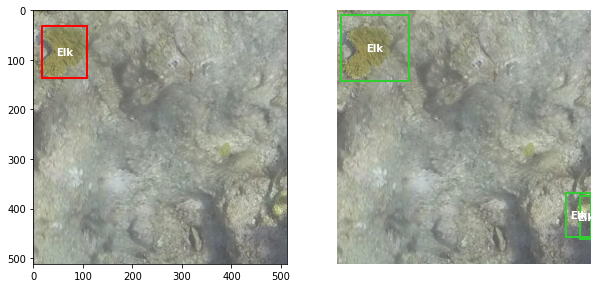

iou  =  0.5138811321340409
elkhorn-1-47-19_jpg.rf.104a3823008c161135846a006b4b3326.jpg


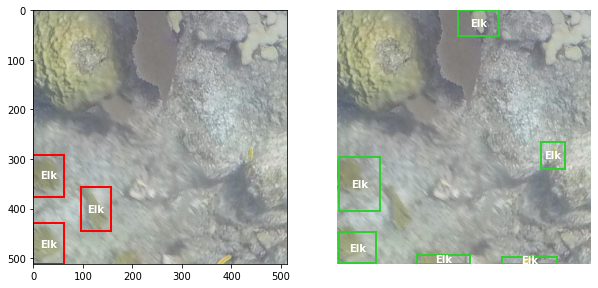

iou  =  0.1595780700070412
elkhorn-1-50-15_jpg.rf.43a647b63f8f4157020ef45652a968e6.jpg


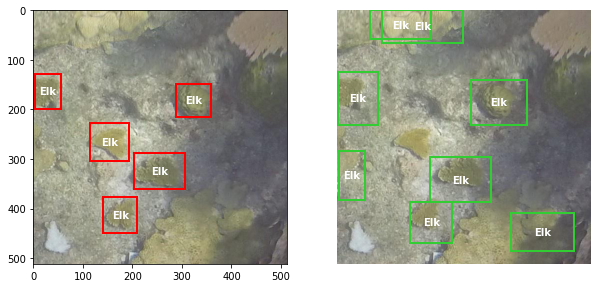

iou  =  0.27306600785910895
elkhorn-1-52-13_jpg.rf.25d8e509a5a0e02fcffcd08465171c20.jpg


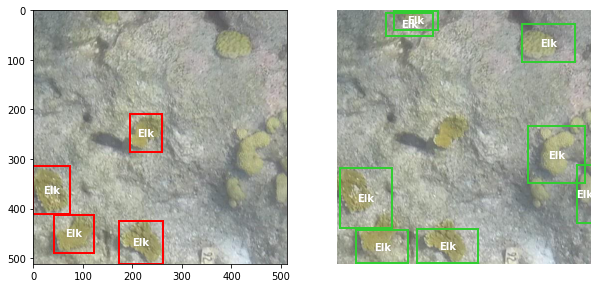

iou  =  0.27287828209514065
elkhorn-1-55-10_jpg.rf.5eed4523e11e78200b6c8c1b3fce83d8.jpg


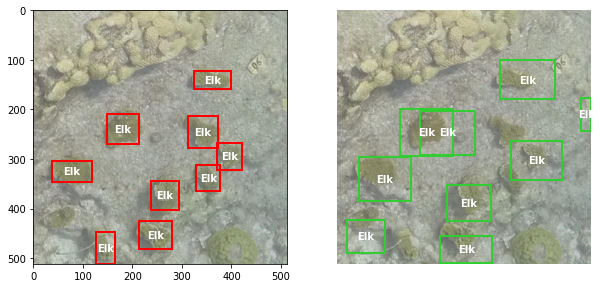

iou  =  0.11486910745736635
elkhorn-1-64-21_jpg.rf.dac912e36314b0abd0874dcbd0878739.jpg


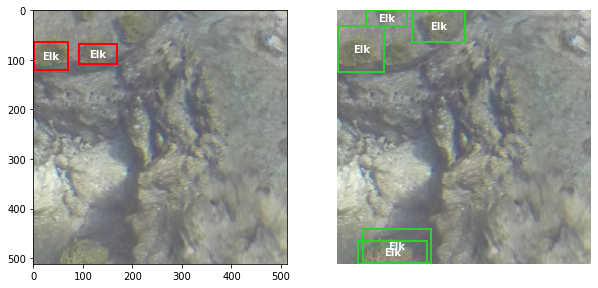

iou  =  0.0021537479414782718
elkhorn-1-66-16_jpg.rf.3e63e9944af8dc2325043db7e6ec52d3.jpg


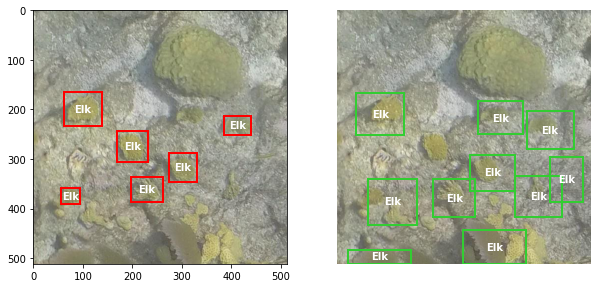

iou  =  0.3081287652313464
elkhorn-1-69-16_jpg.rf.bffea26e8ecc369ce70af1bc1b894a37.jpg


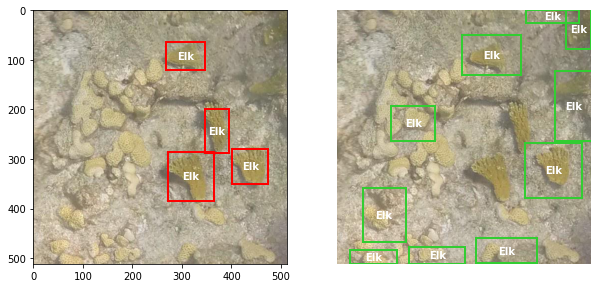

iou  =  0.12053090683255631
elkhorn-1-69-62_jpg.rf.4c5808dce491382a347b28dcab2840bd.jpg


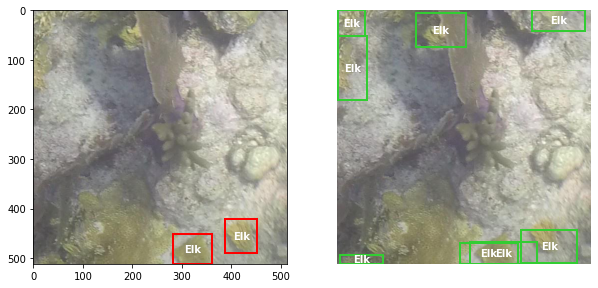

iou  =  0.4319309463051635
elkhorn-1-70-16_jpg.rf.3e01658fc6ed3e5f58e9b71a2bfddc68.jpg


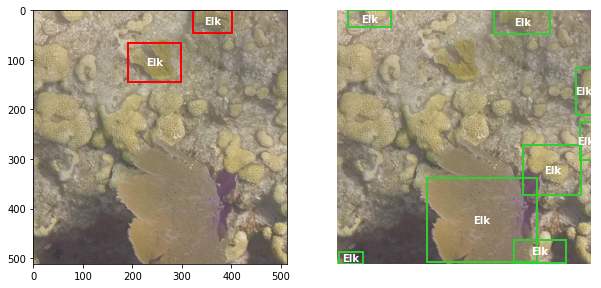

iou  =  0.3245030789220569
elkhorn-1-70-19_jpg.rf.7c65dfad9ebc374697e910b541dc0389.jpg


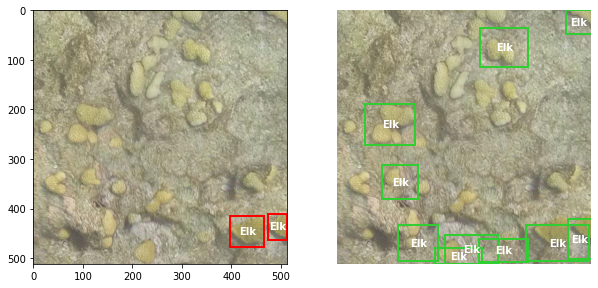

iou  =  0.33249257650843844
elkhorn-1-70-26_jpg.rf.249a341eb3ca83432d2cd7e519bae373.jpg


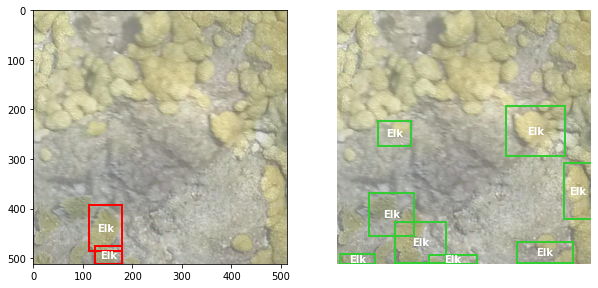

iou  =  0.17317096714716448
elkhorn-1-72-48_jpg.rf.76ea19ab63945de8e6aa029c37aff7e9.jpg


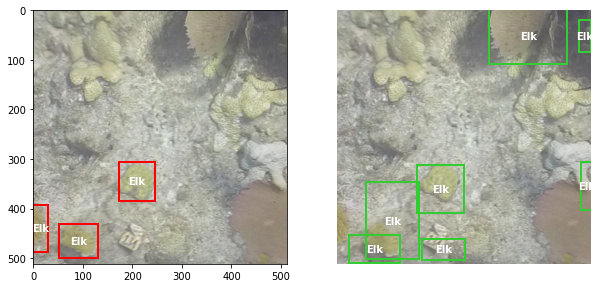

iou  =  0.2864513687762476
elkhorn-1-73-20_jpg.rf.53fab43e308c81c5ac17d78c1f60a2da.jpg


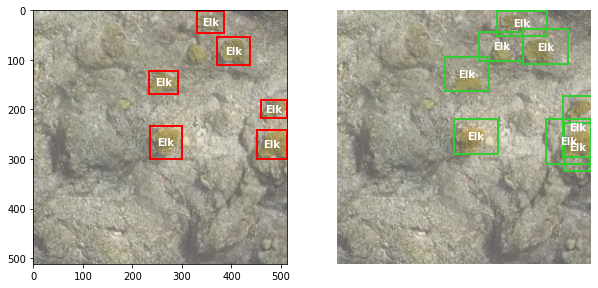

iou  =  0.45283257299048013
elkhorn-1-75-27_jpg.rf.f83d69819f1e5ea504b343b56049a010.jpg


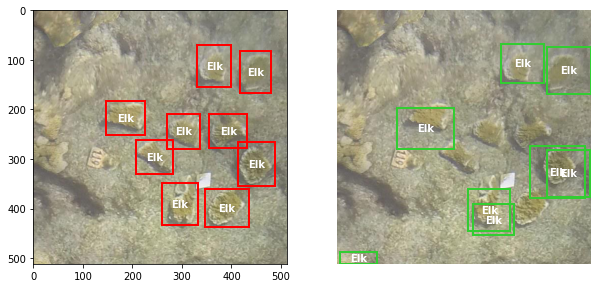

iou  =  0.30344629320641614
elkhorn-1-83-57_jpg.rf.d49d1828949de685a2a8a78bb545ae0b.jpg


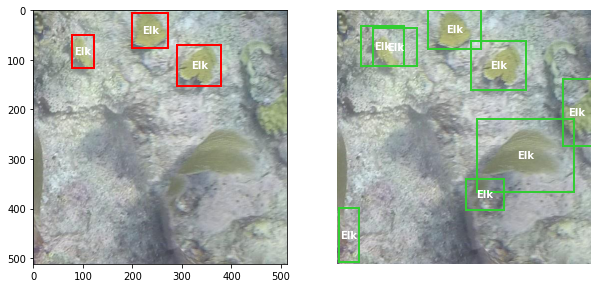

iou  =  0.5628932047395699
elkhorn-2-12-12_jpg.rf.552abefe4cba8ebc4d62113d581baca0.jpg


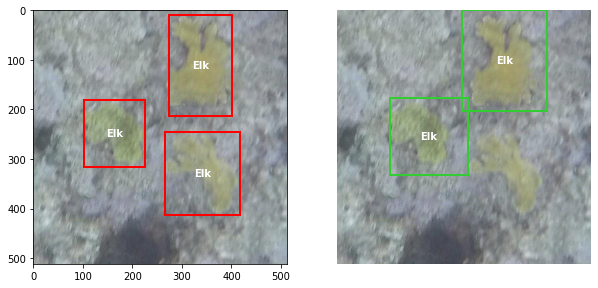

iou  =  0.6702432683859019
elkhorn-2-23-12_jpg.rf.aca06b25cdcd93fb73e61ad1d06355bf.jpg


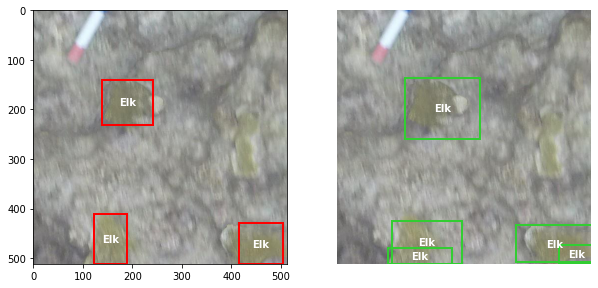

iou  =  0.49169485532982654
elkhorn-2-39-18_jpg.rf.5f5dce6f572451c659bdaa6898bdaf26.jpg


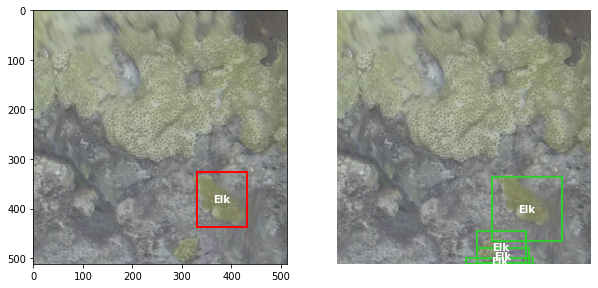

iou  =  0.5353341927567861
elkhorn-2-4-10_jpg.rf.5d8a73b4e82b7c0a69d14d851b39dd53.jpg


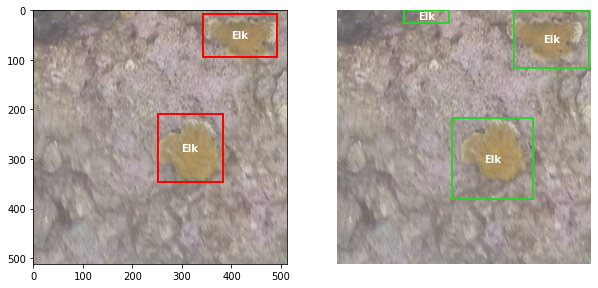

iou  =  0.6131950024777217
elkhorn-2-42-12_jpg.rf.a65e9a567d5e10a7358dfd2d52010e20.jpg


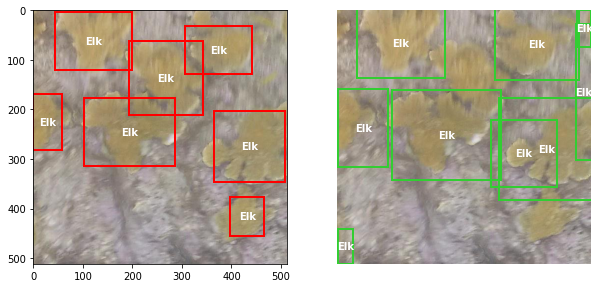

iou  =  0.31975841856986925
elkhorn-2-44-15_jpg.rf.dc7edd88afeff3b5185530aba1677684.jpg


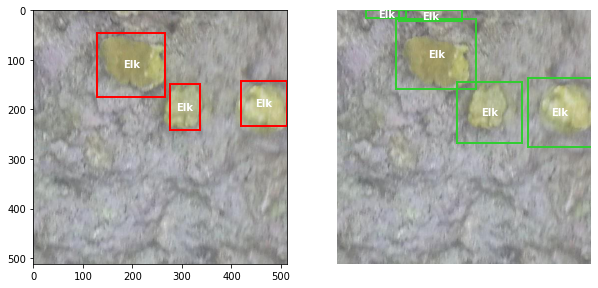

iou  =  0.4787252662248472
elkhorn-2-47-14_jpg.rf.104d435a71b486b9a9b69677f14af1bd.jpg


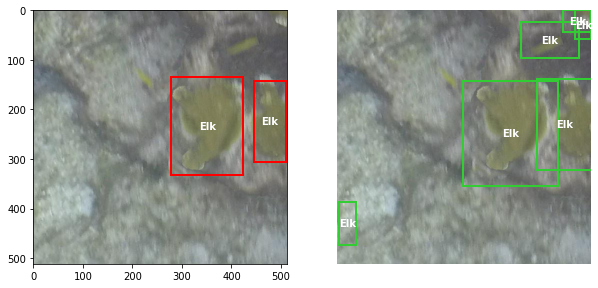

iou  =  0.5880458142092979
elkhorn-2-49-10_jpg.rf.730725103897c7aade039b686897a7fd.jpg


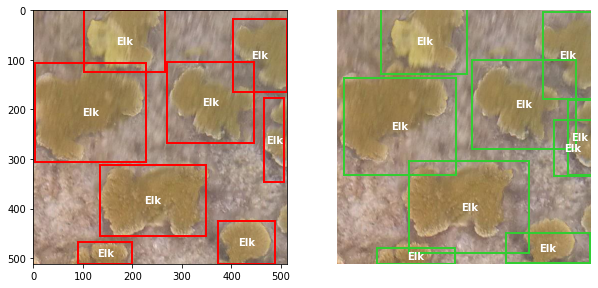

iou  =  0.6863501277350929
elkhorn-2-57-24_jpg.rf.3ae514d49157dce90e81b49d71dfd780.jpg


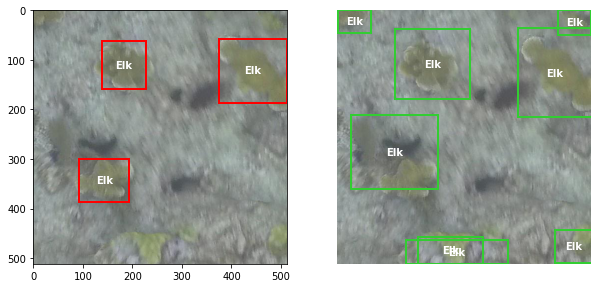

iou  =  0.4243400929803552
elkhorn-2-58-23_jpg.rf.9801fbf598ad6297bec820ecfebbadb7.jpg


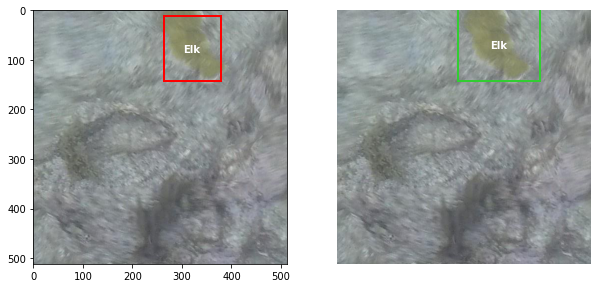

iou  =  0.6212748590786805
elkhorn-3-10-37_jpg.rf.b34ba9d0291241d354c369534d765010.jpg


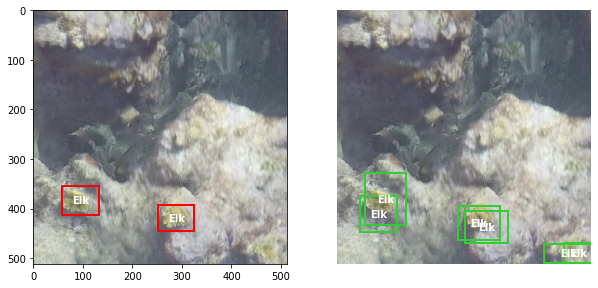

iou  =  0.5591212406742393
elkhorn-3-11-37_jpg.rf.9baa2287c72cfe99e392c0a4cb3131d6.jpg


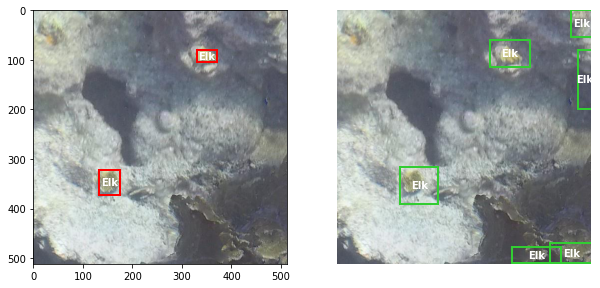

iou  =  0.2929079414046497
elkhorn-3-12-13_jpg.rf.fae6e3631e88e5ed7c8f71f0d29b2ad4.jpg


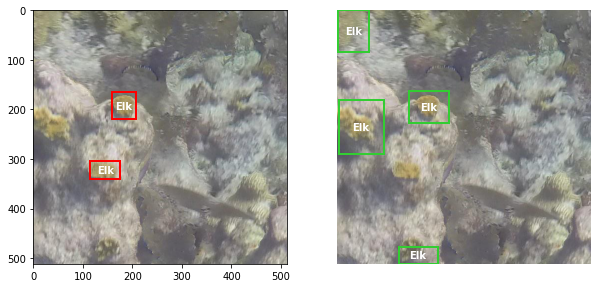

iou  =  0.26469046670004104
elkhorn-3-12-14_jpg.rf.39f4a68ace16bb376e6a66491cf21ccd.jpg


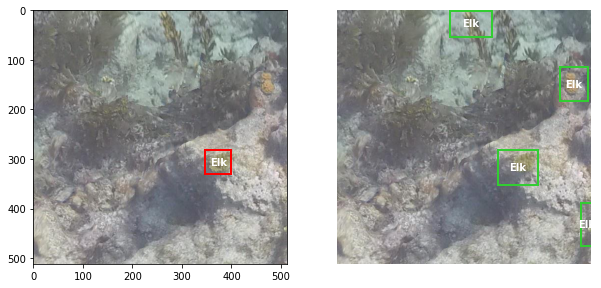

iou  =  0.4379695750941506
elkhorn-3-12-36_jpg.rf.5792ef295d0c3ea6918e49c49ef5f4d9.jpg


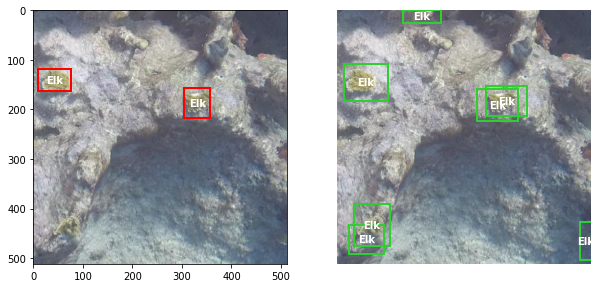

iou  =  0.48824384115009
elkhorn-3-13-10_jpg.rf.4e201ae938e2fabab0338d19b51fbe9b.jpg


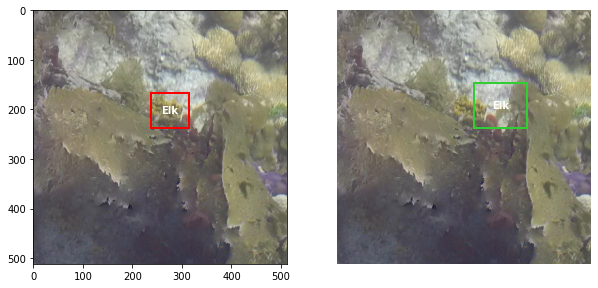

iou  =  0.22920625589120275
elkhorn-3-14-15_jpg.rf.bbfabd866868e9364860004e0394ec21.jpg


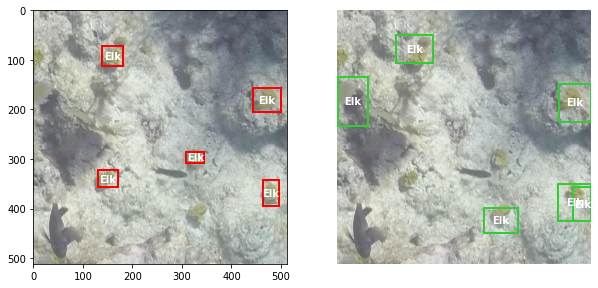

iou  =  0.22161392570377975
elkhorn-3-15-15_jpg.rf.0ca9e450fc39c48b7cfa0472f7033339.jpg


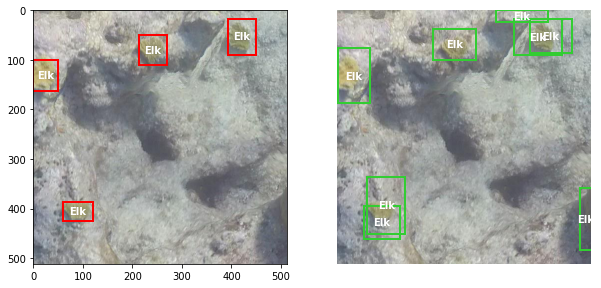

iou  =  0.47915782403534085
elkhorn-3-16-13_jpg.rf.52c5182acbd5c7194cd16b45c57f55ea.jpg


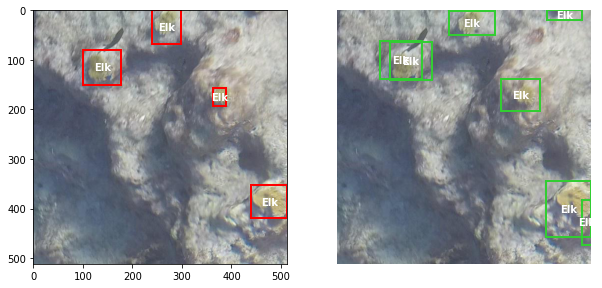

iou  =  0.43672454048528697
elkhorn-3-16-16_jpg.rf.a7a4da0a954543a688fc65936117f7da.jpg


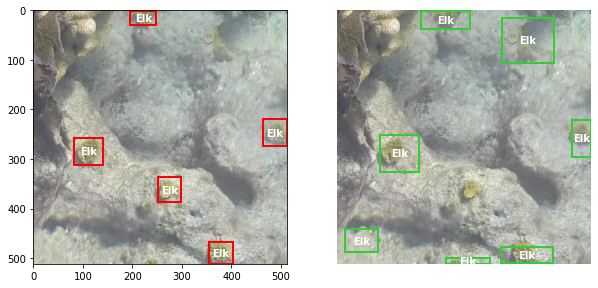

iou  =  0.3874707787388397
elkhorn-3-16-8_jpg.rf.09ac619a77edf9da8372a308e9b84b91.jpg


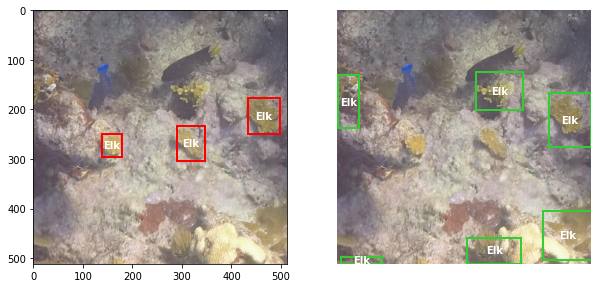

iou  =  0.1683189571751121
elkhorn-3-21-10_jpg.rf.46fc3d5401677b577e76bf13f2b94dba.jpg


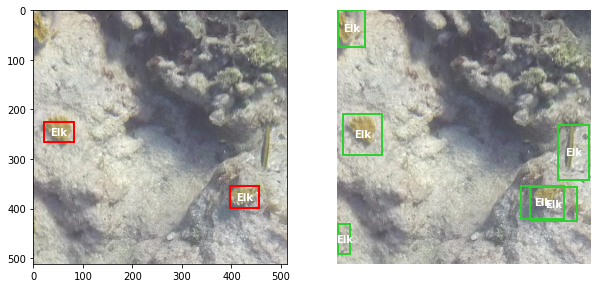

iou  =  0.40101682253993576
elkhorn-3-22-10_jpg.rf.0f4055b5e657b1ba0da3d609e28cdeeb.jpg


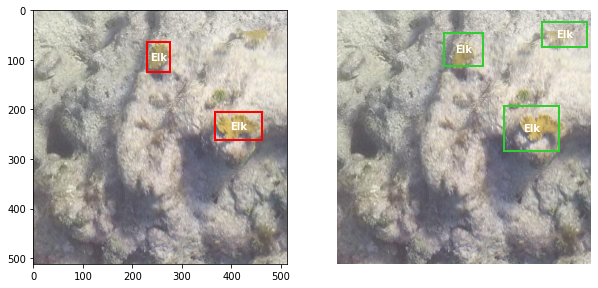

iou  =  0.4019570484144672
elkhorn-3-23-14_jpg.rf.d49eaf0a9893c1ac5cded2b9087abf10.jpg


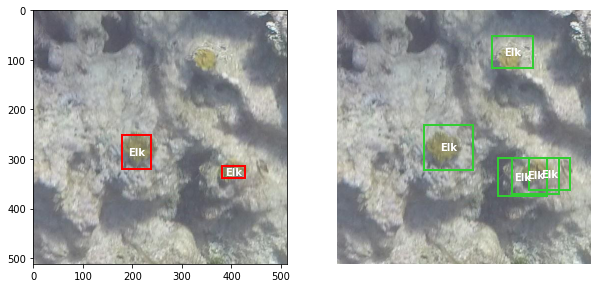

iou  =  0.3156497379692388
elkhorn-3-26-35_jpg.rf.c3b66d07135d530d3b1754d9d3c62062.jpg


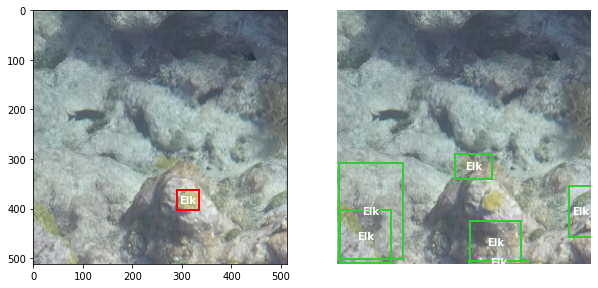

iou  =  0.0
elkhorn-3-26-36_jpg.rf.cabd1e9c6c0d76014d2fd5f64c9bb938.jpg


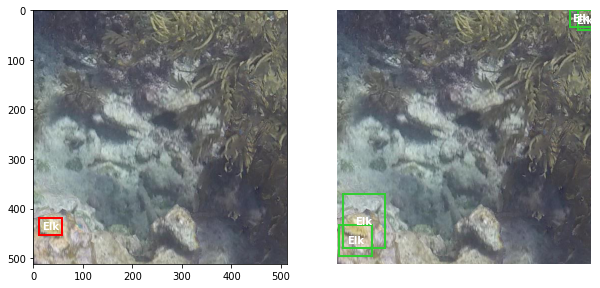

iou  =  0.21034651713222471
elkhorn-3-28-36_jpg.rf.34d328240ecd0e2853f72a6bbd278f9c.jpg


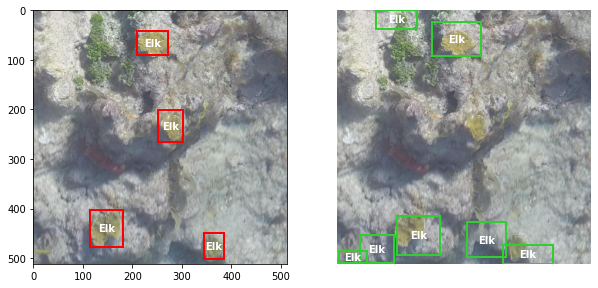

iou  =  0.2955223794030082
elkhorn-3-28-37_jpg.rf.b233e7a6bf87801b843da7ecf1d1361f.jpg


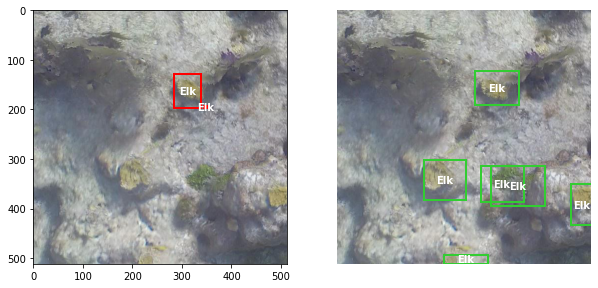

iou  =  0.2634265610376326
elkhorn-4-10-14_jpg.rf.af459e30872f342640151297e34fd57d.jpg


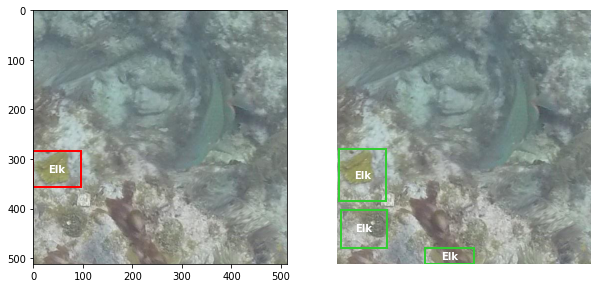

iou  =  0.6890348101098681
elkhorn-4-10-32_jpg.rf.11bcb9844697c4c360692ccfd856489d.jpg


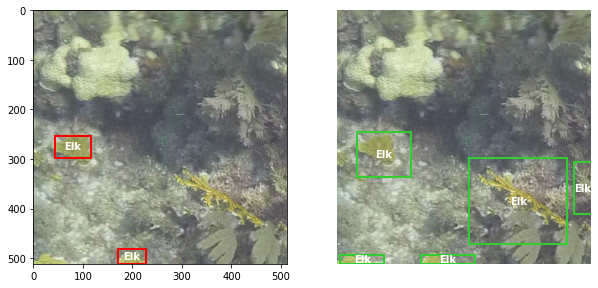

iou  =  0.3629924099303784
elkhorn-4-10-33_jpg.rf.233a47193028dd56aa8386239daf0a96.jpg


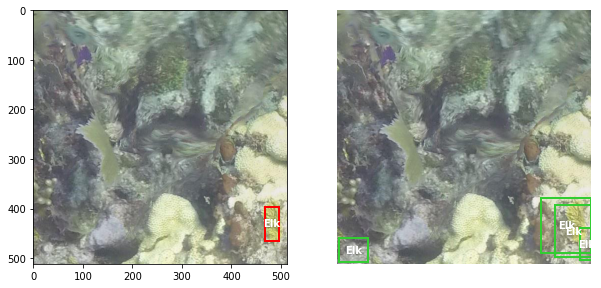

iou  =  0.24161510518647417
elkhorn-4-11-26_jpg.rf.3e557a14a1633df498b517a8e87c63a3.jpg


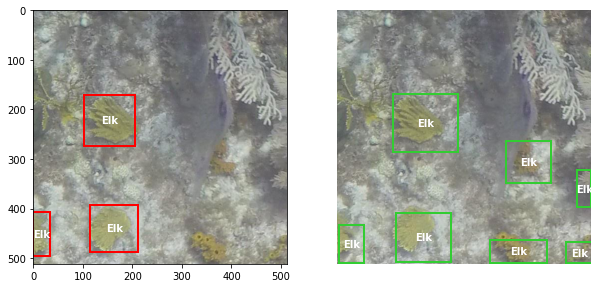

iou  =  0.5245808116809002
elkhorn-4-11-40_jpg.rf.250a520e8ae058899f96fc81dc2a5828.jpg


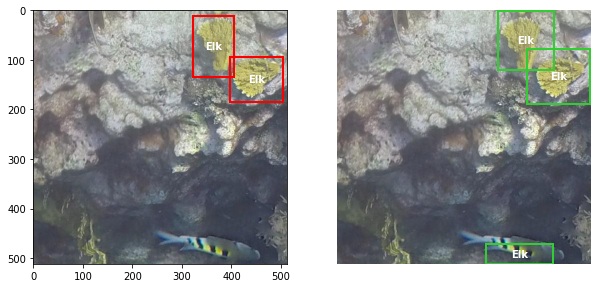

iou  =  0.658021831829628
elkhorn-4-11-41_jpg.rf.6c51a90573c0cabf44eefd48a2e876ca.jpg


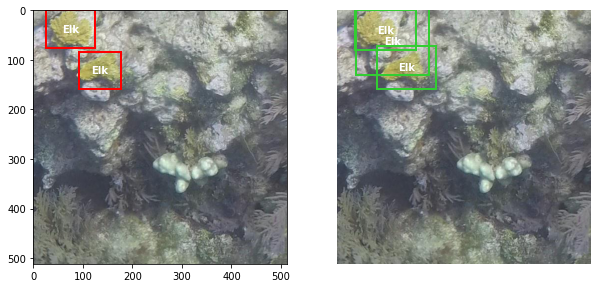

iou  =  0.6199850599442324
elkhorn-4-12-11_jpg.rf.6e4af4f271a0849f8ec6e3c11310400a.jpg


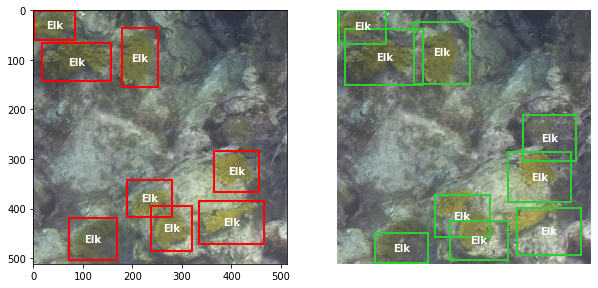

iou  =  0.5212106269399541
elkhorn-4-12-14_jpg.rf.225cccd3b3c2da24d26815dbd11af88f.jpg


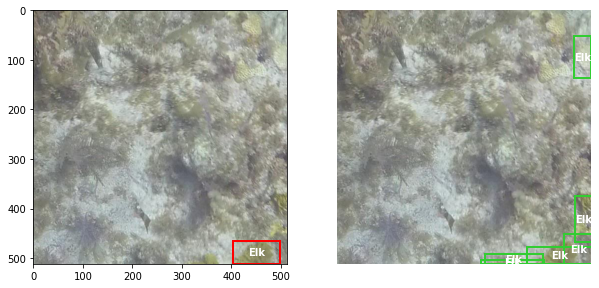

iou  =  0.5507659515692269
elkhorn-4-13-11_jpg.rf.b49fd7b93676efe6088a14fc34b45fee.jpg


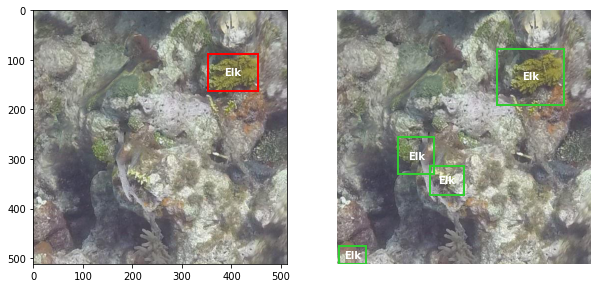

iou  =  0.49965950825219263
elkhorn-4-13-14_jpg.rf.2c3bdaa2667d763faf97fa48c69009b7.jpg


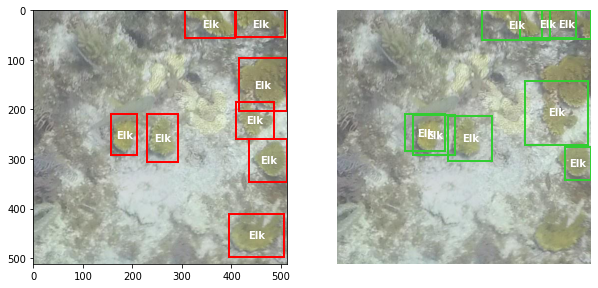

iou  =  0.3878652216727027
elkhorn-4-13-15_jpg.rf.f6f640454319fe0436942356a4fa709c.jpg


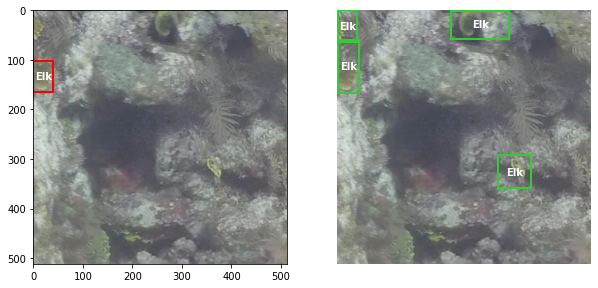

iou  =  0.5264985949003389
elkhorn-4-13-21_jpg.rf.c1c99700af802e6647416e75be5df381.jpg


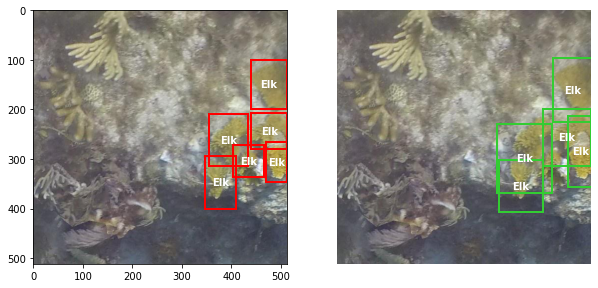

iou  =  0.41949760955787696
elkhorn-4-13-22_jpg.rf.a162ee2ba5e2418be715d397cd54794f.jpg


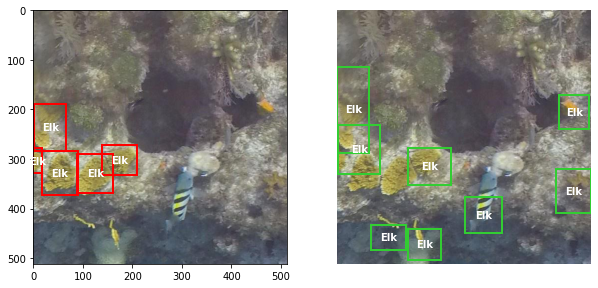

iou  =  0.22800335777546765
elkhorn-4-14-10_jpg.rf.e687202ed06de38d3a69721d03124ac6.jpg


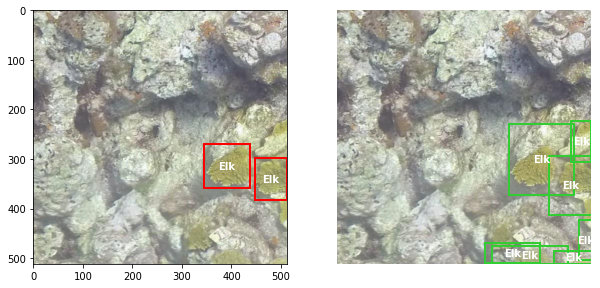

iou  =  0.47649085196552143
elkhorn-4-14-7_jpg.rf.f336cb17927071016960bdeeb2af8c0e.jpg


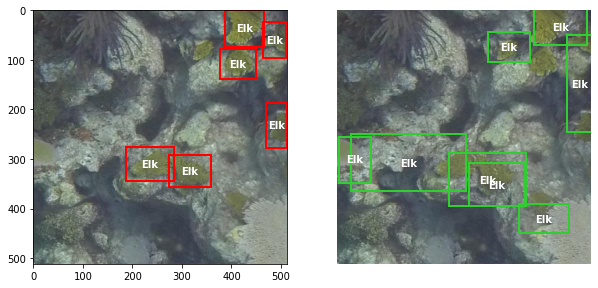

iou  =  0.22664389175364041
elkhorn-4-17-12_jpg.rf.d3f535f601fd7dcf9f300e63e0aa2b21.jpg


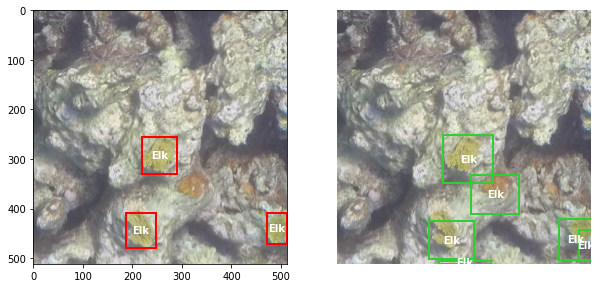

iou  =  0.42356541955646865
elkhorn-4-18-10_jpg.rf.9ddd6e8083075ed9d51bce01d6f73524.jpg


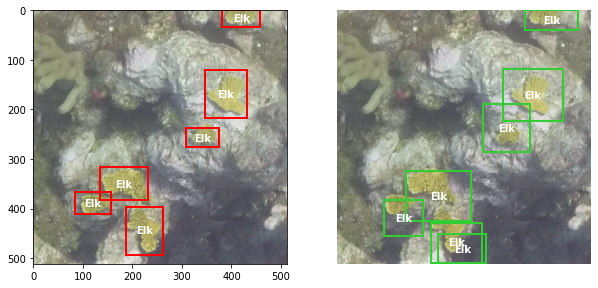

iou  =  0.42520908680994784
elkhorn-4-19-8_jpg.rf.0aef15257c19058f82b0edb15f00b403.jpg


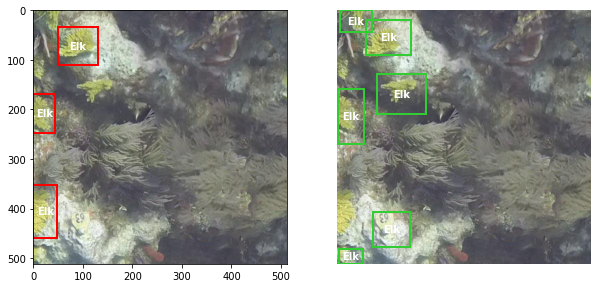

iou  =  0.3532918834890137
elkhorn-4-20-10_jpg.rf.4ced79bfa64a630eccf756ac22274627.jpg


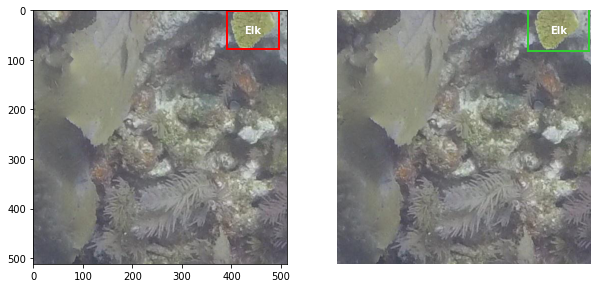

iou  =  0.7521100015190367
elkhorn-4-26-6_jpg.rf.387e57323b000380c2647a003b10923e.jpg


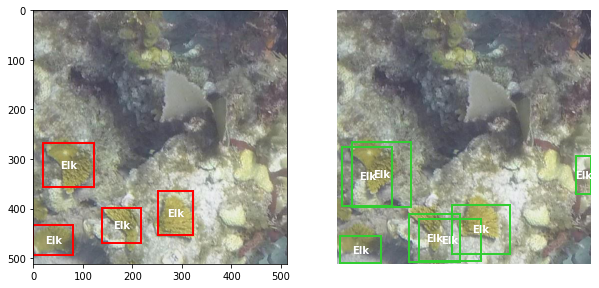

iou  =  0.4174155215769574
elkhorn-4-26-7_jpg.rf.90a7bfe0e9bab40c993d84dd074496df.jpg


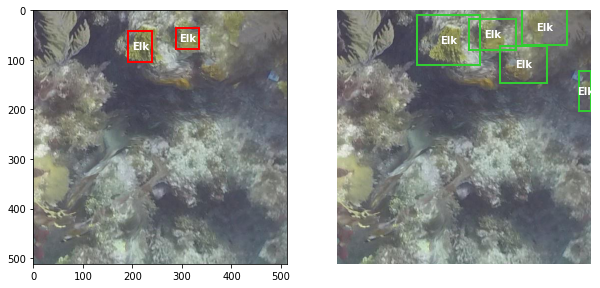

iou  =  0.2824683651761046
elkhorn-4-31-11_jpg.rf.c9c8e32a699d448a9b9fe0d87fe32218.jpg


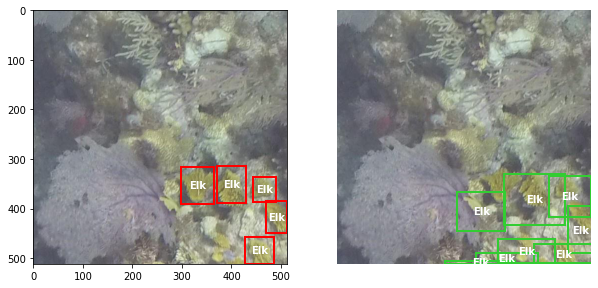

iou  =  0.3112404542382082
elkhorn-4-37-11_jpg.rf.a7d34bbff91e2f393ec0eeca07c24832.jpg


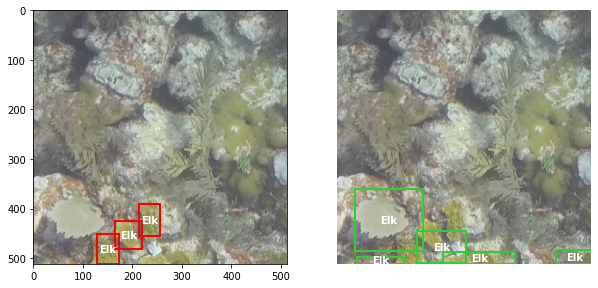

iou  =  0.03230344012422733
elkhorn-4-42-7_jpg.rf.d5b273db4d368a3ca94f80967596de63.jpg


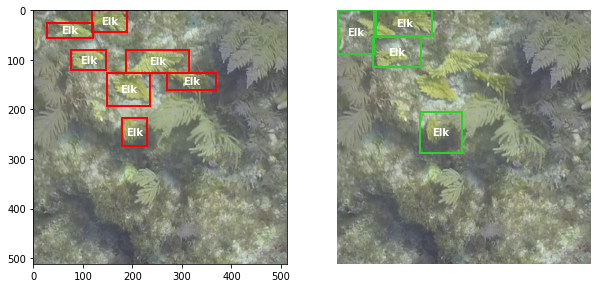

iou  =  0.09582970878616287
elkhorn-4-43-6_jpg.rf.dbb57c0ab706db551fec6e1e321e623f.jpg


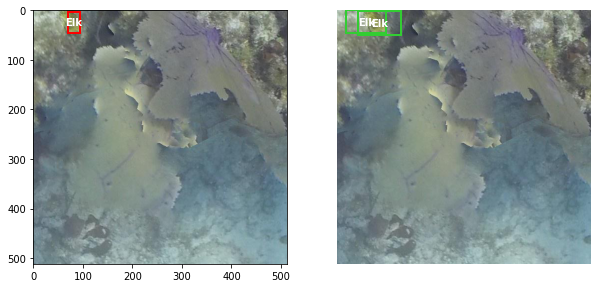

iou  =  0.29213458720020813
elkhorn-4-44-9_jpg.rf.aab3570d69d737e44f3995d2b4e7dfe4.jpg


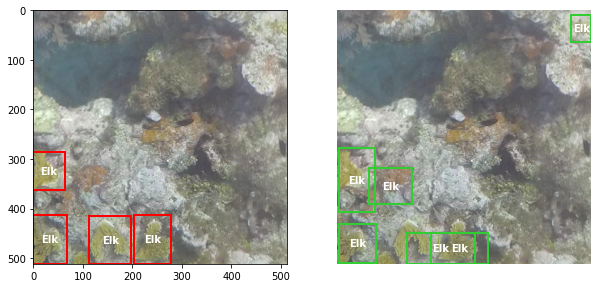

iou  =  0.4735945273625301
elkhorn-4-9-39_jpg.rf.f8cafcac08c5efac0c2f78082e89554f.jpg
elkhorn-5-14-14_jpg.rf.4a6f21a57aa64b7d17e57ec62e9af284.jpg


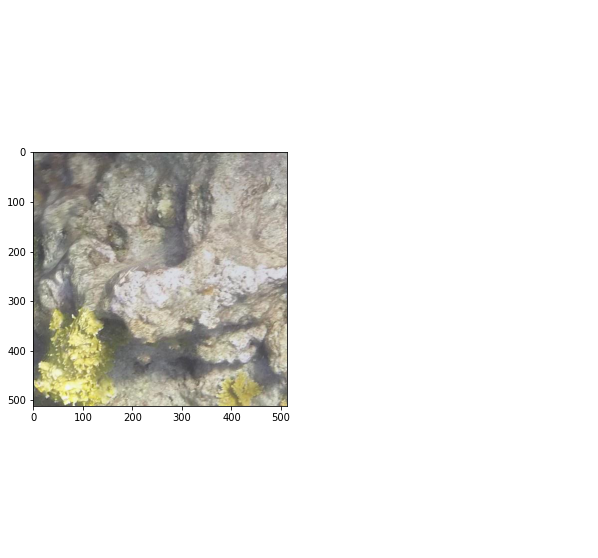

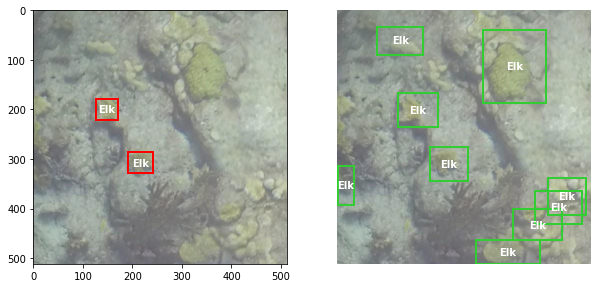

iou  =  0.368736016971251
elkhorn-5-20-8_jpg.rf.a6e134dc9f88a84560370f9155be0af1.jpg


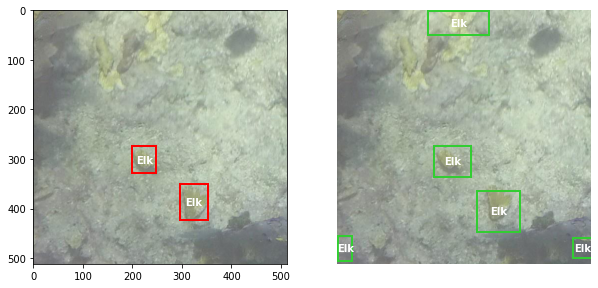

iou  =  0.48992972761560316
elkhorn-5-21-15_jpg.rf.8d91254f969dce0e6f19cf244afd65a8.jpg


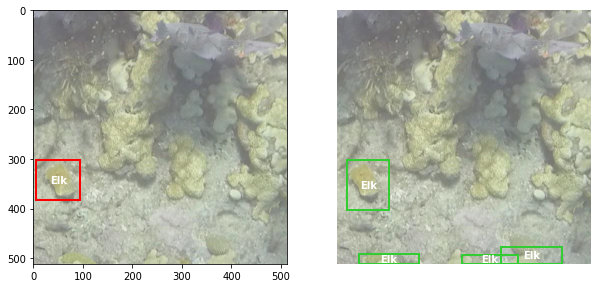

iou  =  0.6225226891136908
elkhorn-5-21-8_jpg.rf.a343be90989f5e25bd97cf6d6b2e3354.jpg


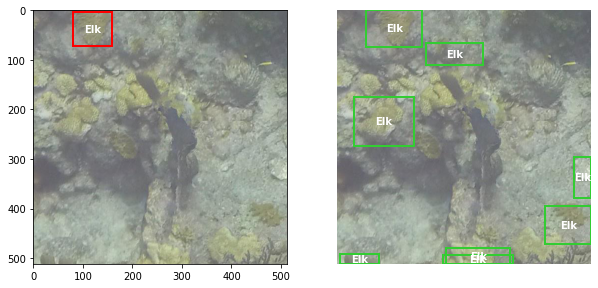

iou  =  0.6296387194740547
elkhorn-5-22-9_jpg.rf.9340bdbb902b69307a039f91e69c91ae.jpg


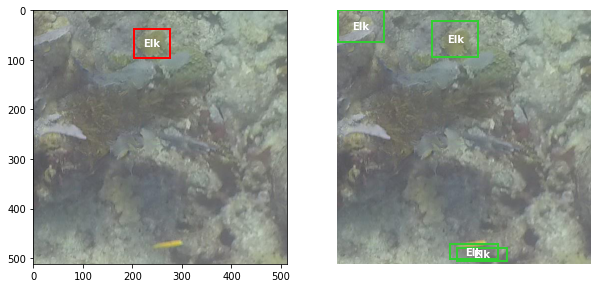

iou  =  0.5825779881377398
elkhorn-5-23-17_jpg.rf.eb54406b6ab7e2f78c8c61d62d3d6c20.jpg


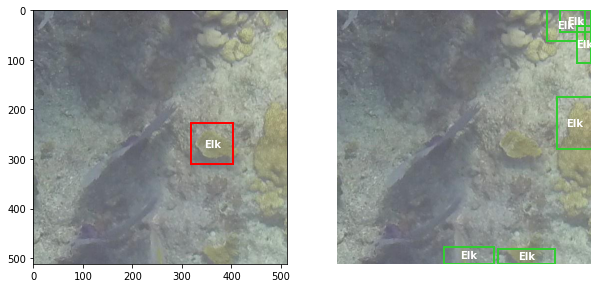

iou  =  0.0
elkhorn-5-33-17_jpg.rf.b988b45e5e12ecb76e395db7fde6bcc3.jpg


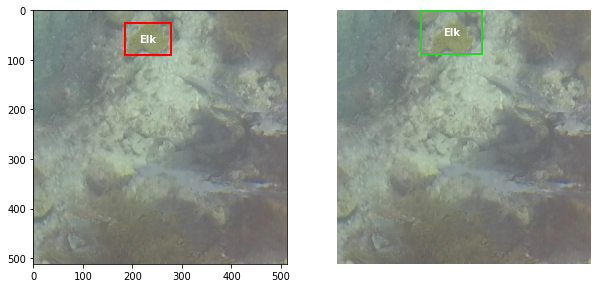

iou  =  0.5231329249478492
elkhorn-5-36-18_jpg.rf.2c41d1f8ffcb6f21b724af257b3f5f76.jpg


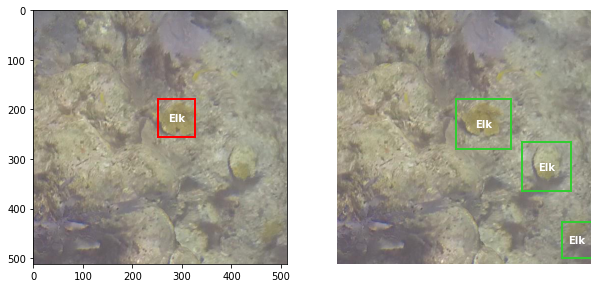

iou  =  0.49485283429378163
elkhorn-5-41-11_jpg.rf.91cabdfbfaca42502fbc3712ce7cf0c6.jpg


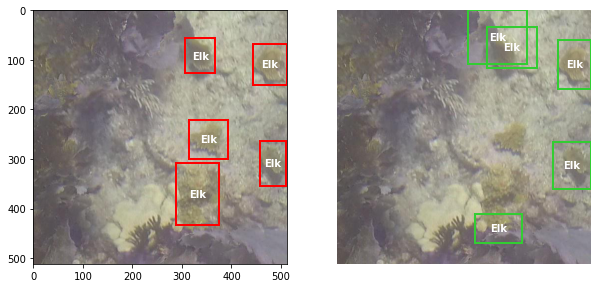

iou  =  0.39709733973631095
staghorn-1-16-15_jpg.rf.198f4a072c6d30b9b944d0c402ad665f.jpg


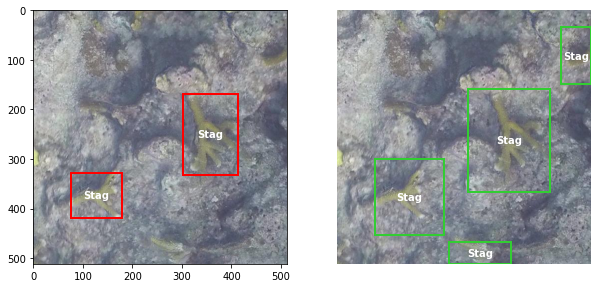

iou  =  0.48377151096038706
staghorn-1-16-16_jpg.rf.ef9f75a9bde58ed6c93be8c446f1a5cc.jpg


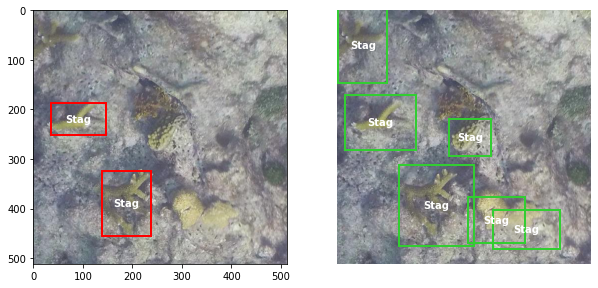

iou  =  0.4954888893743692
staghorn-1-17-15_jpg.rf.c2c86df44e6d897763525e9336a65984.jpg


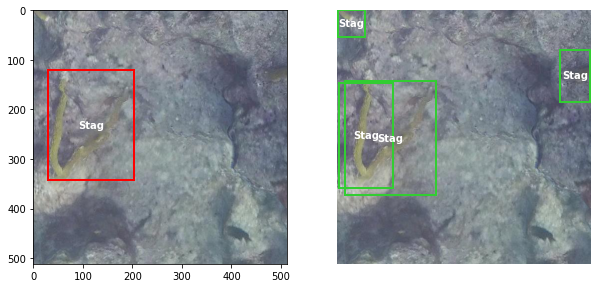

iou  =  0.7166725680444458
staghorn-1-17-16_jpg.rf.dea62911d5549eccb85eb5985242c7e5.jpg


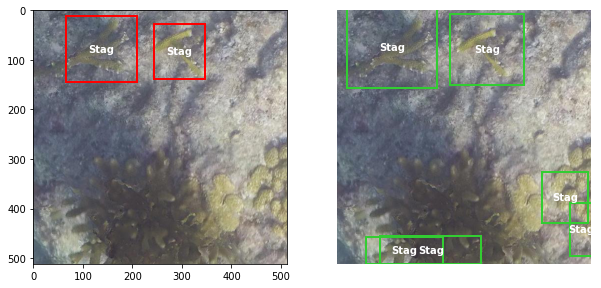

iou  =  0.5507486986970112
staghorn-1-24-12_jpg.rf.1b720ee8908c941e0d0d1b04a42f9d63.jpg


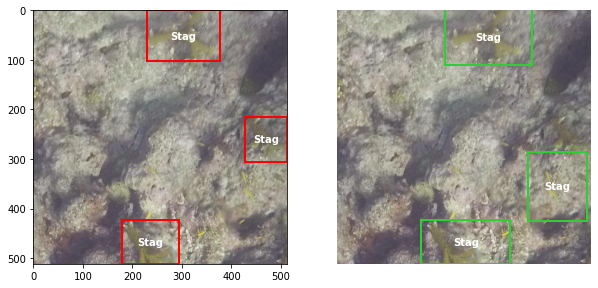

iou  =  0.4909256204518469
staghorn-1-24-19_jpg.rf.1d6b864e88bb89239756de800cdc5867.jpg


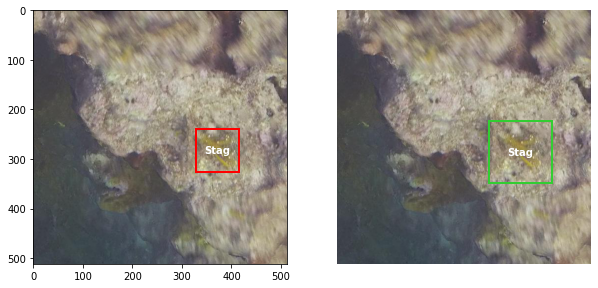

iou  =  0.48442052603911157
staghorn-1-26-16_jpg.rf.8b0dc7a9f85a884ad165497db8de94ac.jpg


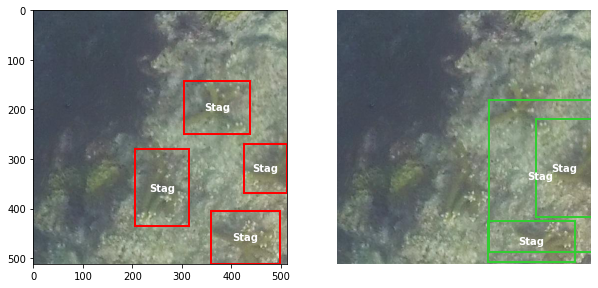

iou  =  0.17136727605768196
staghorn-1-31-16_jpg.rf.b26ff310f189b603cbbde48867563ff0.jpg


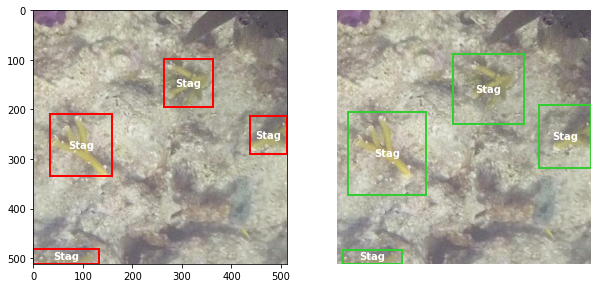

iou  =  0.5791648120806747
staghorn-1-32-17_jpg.rf.7577e10a81c0b3bec414d077c5c8702f.jpg


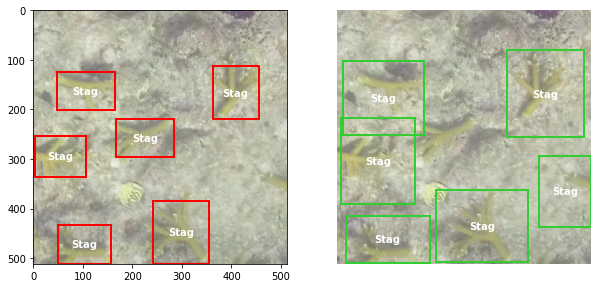

iou  =  0.2582426385276873
staghorn-1-33-15_jpg.rf.38bdeca9399ef887404047c4da322f1c.jpg


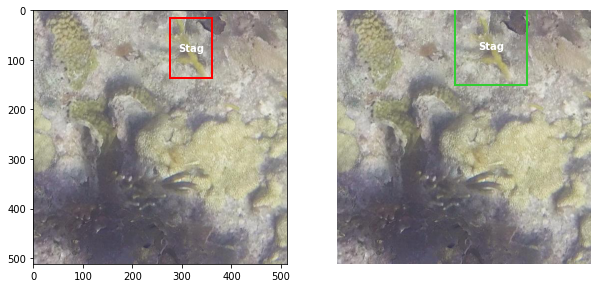

iou  =  0.4694039025149552
staghorn-1-34-18_jpg.rf.6f326aae4f3a60313c231cd30233e57e.jpg


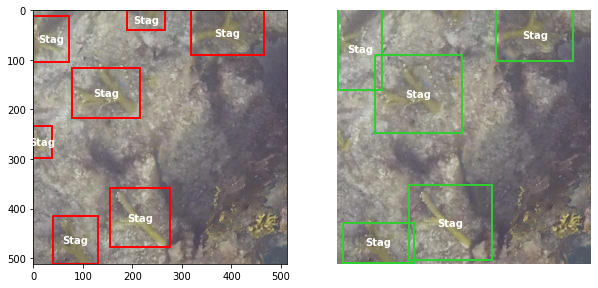

iou  =  0.2122405813806751
staghorn-1-36-10_jpg.rf.17d5b61ae54fe6f9cf329759e8a57dd5.jpg


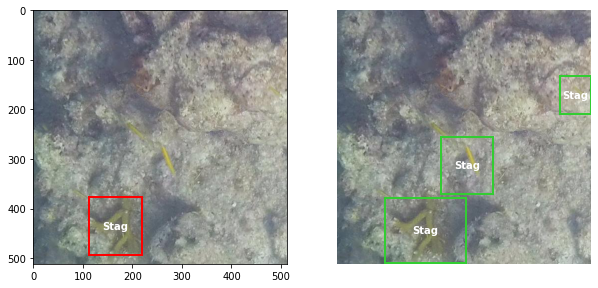

iou  =  0.5668873396439562
staghorn-1-64-20_jpg.rf.9fc41470a63e6238614fbb0c361b851b.jpg


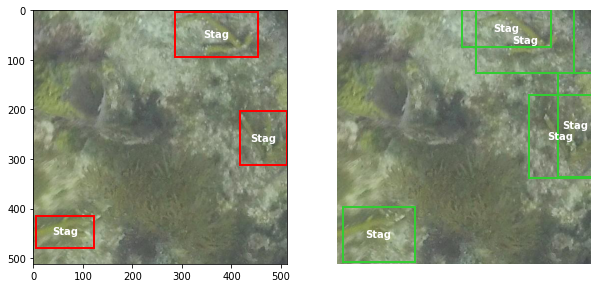

iou  =  0.5036510829747428
staghorn-1-65-14_jpg.rf.906c581e8f3757b647427c363536e495.jpg


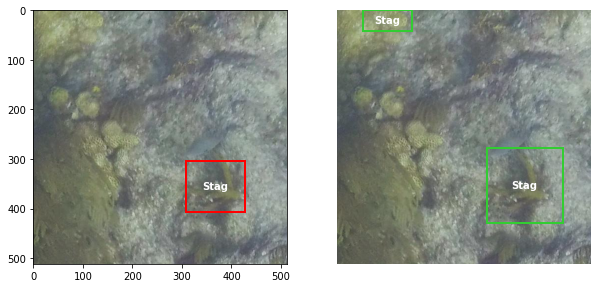

iou  =  0.5246168468661325
staghorn-1-65-19_jpg.rf.fee7902fbe97a89b919ed8e303cb9666.jpg


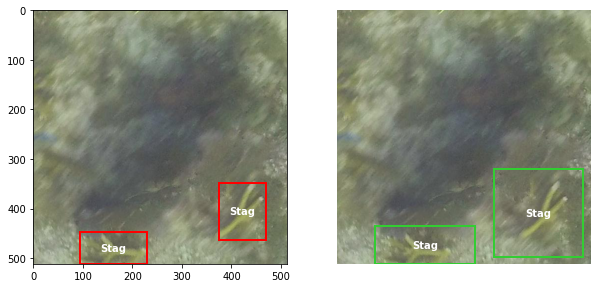

iou  =  0.4500292872330719
staghorn-1-75-23_jpg.rf.ef7661999baaeb921b28e33a02484196.jpg


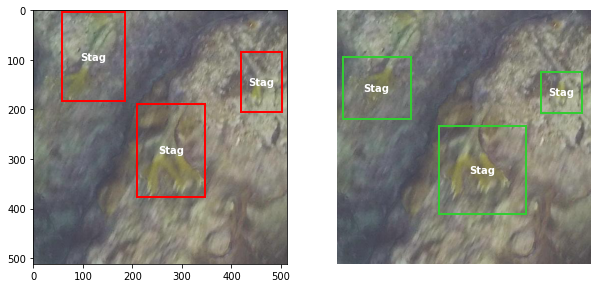

iou  =  0.44241953349771274
staghorn-1-83-19_jpg.rf.7e4bfb4aa7cf1962e7126b68ba2be7ce.jpg


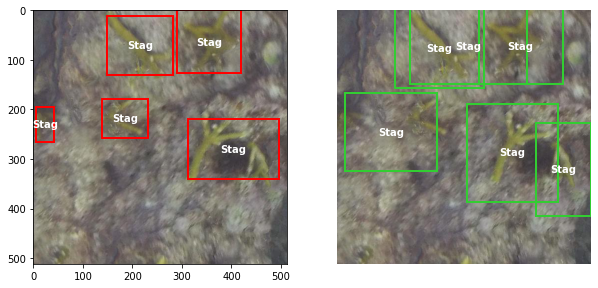

iou  =  0.34141401678673594
staghorn-1-88-9_jpg.rf.36e857f7f648d201673801dc81bbeab0.jpg


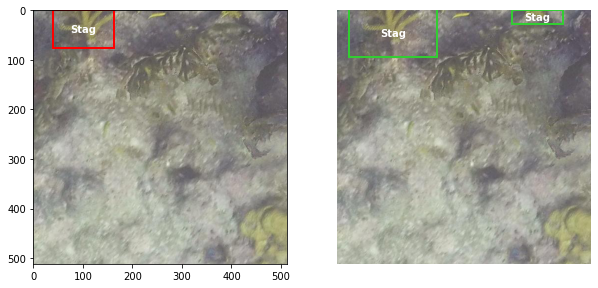

iou  =  0.5380676889340855
staghorn-1-89-13_jpg.rf.d58fd593514950b54943ca894f3ec870.jpg


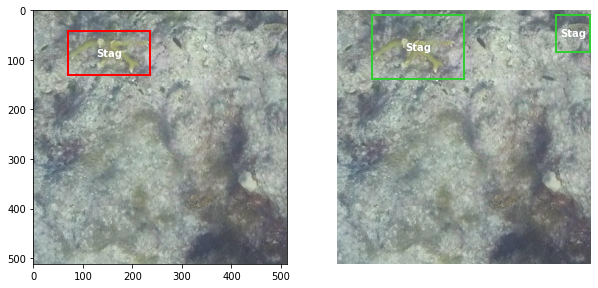

iou  =  0.6149608328804731
staghorn-1-94-22_jpg.rf.6909e75919ff2bba5d68312b21b6d74b.jpg


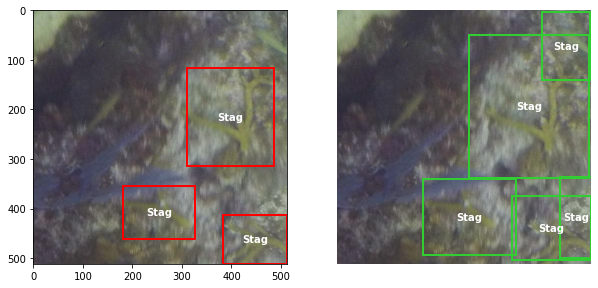

iou  =  0.5262521695103708
staghorn-2-10-40_jpg.rf.69a4e9f03d8b1af30226a38a56bca805.jpg
staghorn-2-12-32_jpg.rf.162044080425fb6dba71a831bd68167d.jpg


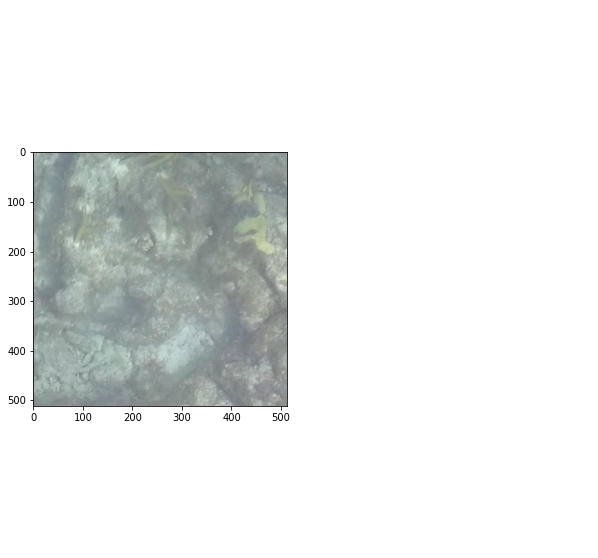

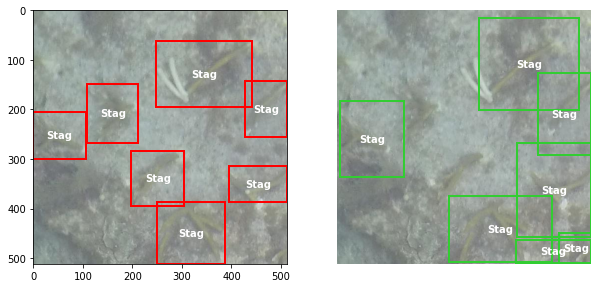

iou  =  0.2029309654396086
staghorn-2-12-40_jpg.rf.37c4314054f259ac58698fa0ac76df84.jpg


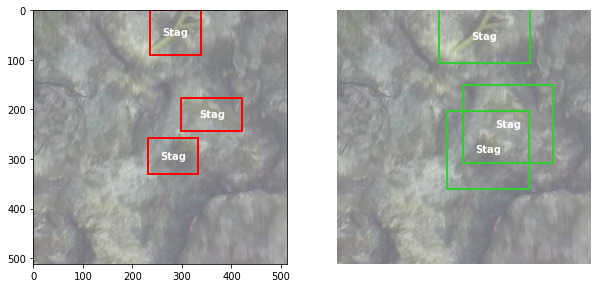

iou  =  0.34821800660823055
staghorn-2-14-33_jpg.rf.e4e0946cef6f7cec7e15de4ef39282d8.jpg


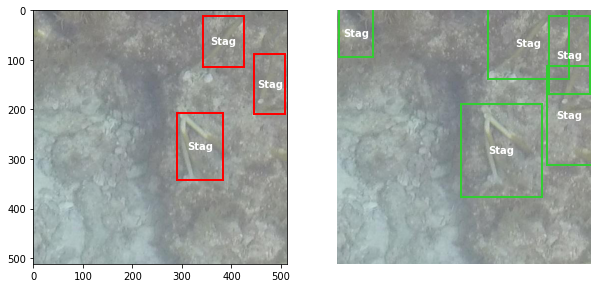

iou  =  0.3665991625968143
staghorn-2-19-19_jpg.rf.4e099ab3cde0e8b1f3042284d08ea73b.jpg


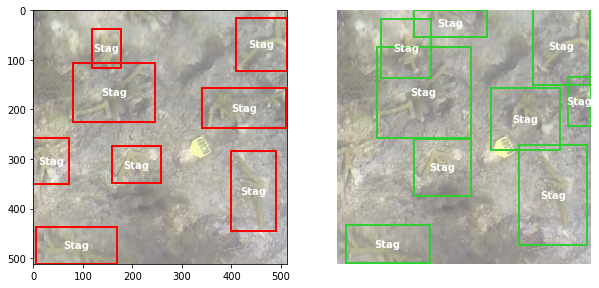

iou  =  0.2560855537586992
staghorn-2-19-20_jpg.rf.165baf14080456b84d6d0e513d0ce950.jpg


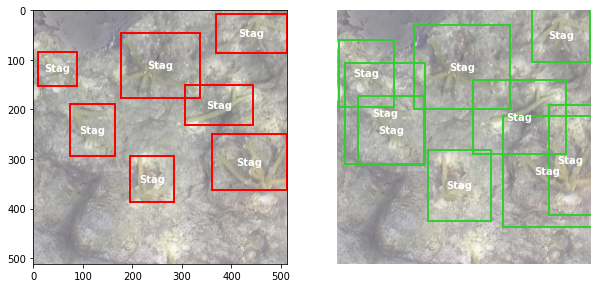

iou  =  0.4864082884347355
staghorn-2-19-21_jpg.rf.eff73bc04d8a1db0ad31c73bb1ac9ef6.jpg


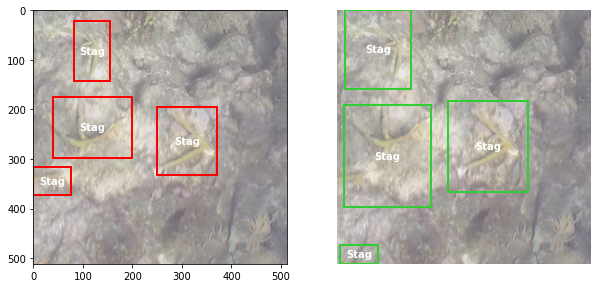

iou  =  0.3305677577393867
staghorn-2-20-34_jpg.rf.21cd42f01a6e8eaf67a35948944737a7.jpg


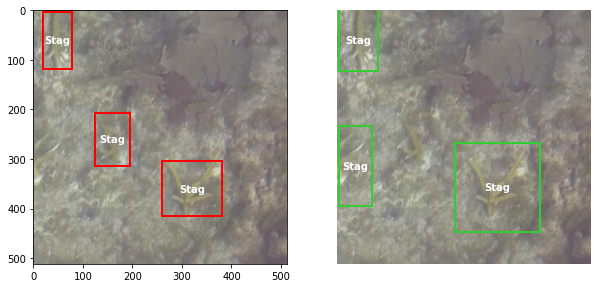

iou  =  0.37516177525249433
staghorn-2-20-35_jpg.rf.3cb4d62773edfe766f03b70d87b80823.jpg


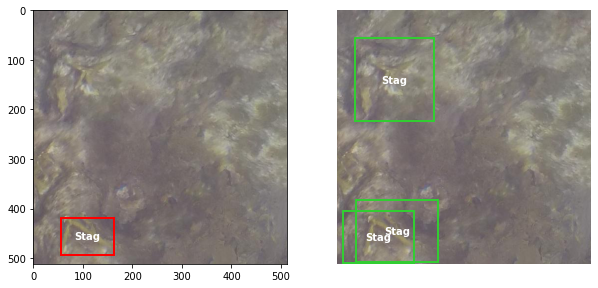

iou  =  0.4815157703018419
staghorn-2-21-35_jpg.rf.5a2c8d174f3c81046b899b8ad5436c22.jpg


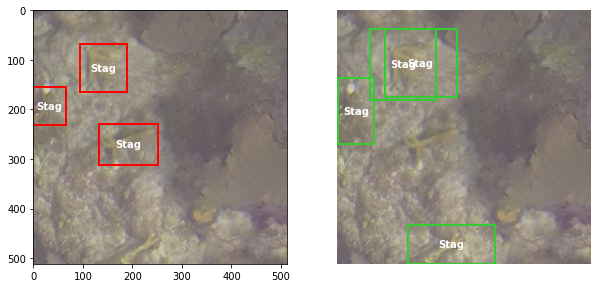

iou  =  0.3310990098556385
staghorn-2-26-14_jpg.rf.4023f784a8414fbfbf4f2766217af093.jpg


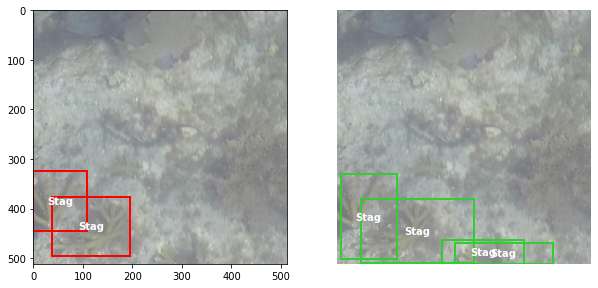

iou  =  0.5555754815204955
staghorn-2-26-37_jpg.rf.7274bff2544b87d194d9584e8ae73da5.jpg


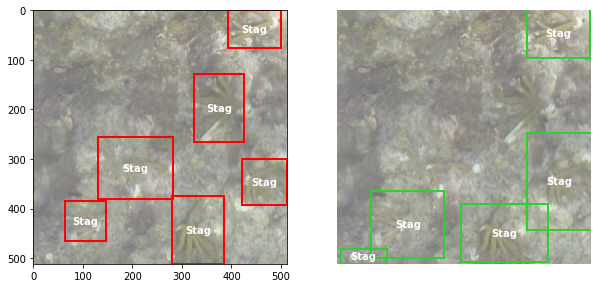

iou  =  0.1377394399027064
staghorn-2-28-13_jpg.rf.4b46bb52a5898aae86c6e8719b2ac623.jpg


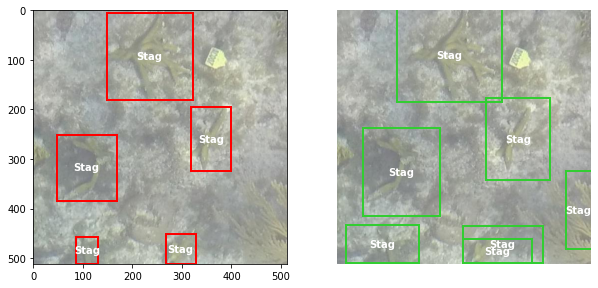

iou  =  0.4829092339272229
staghorn-2-29-10_jpg.rf.82dd82e580ba0bac1603607dc70824d7.jpg


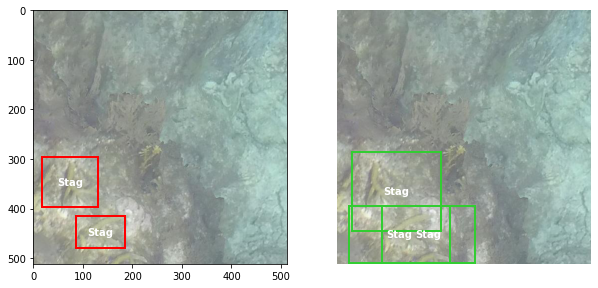

iou  =  0.3144348987899193
staghorn-2-29-14_jpg.rf.b06eec8ab2860e0c894209779e7fcb29.jpg


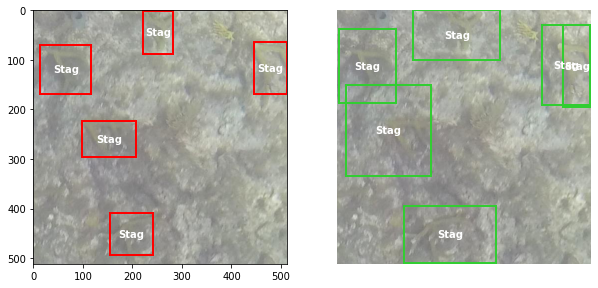

iou  =  0.3987145550074584
staghorn-2-29-23_jpg.rf.d669b2c3fdac78fa4539e8c0ac82c536.jpg


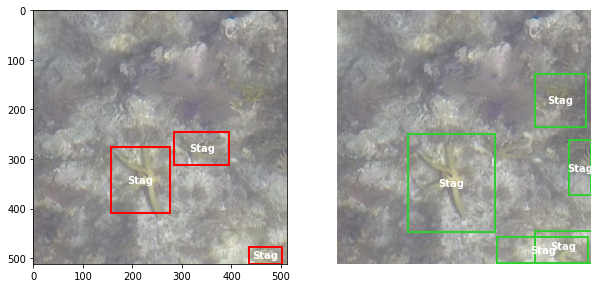

iou  =  0.10807729424561895
staghorn-2-29-25_jpg.rf.dafe2388041a482d54786992cd4e4547.jpg


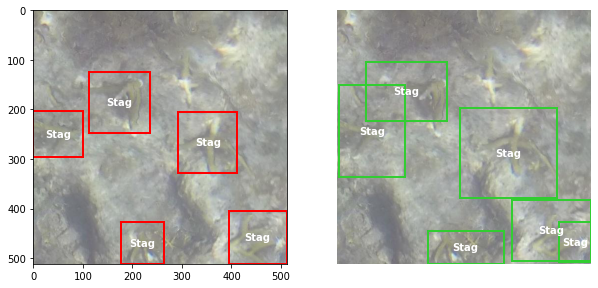

iou  =  0.45101171869185164
staghorn-2-33-17_jpg.rf.0fb04adc7cfde8d0e26e965c92330fcb.jpg


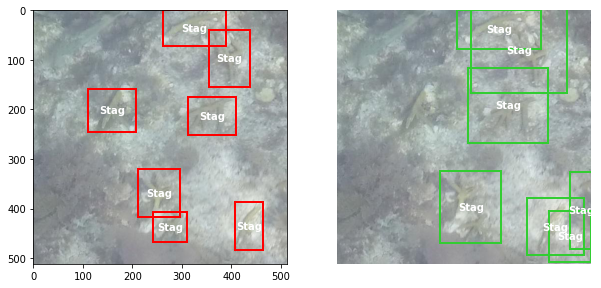

iou  =  0.26355002701895064
staghorn-2-43-17_jpg.rf.20cf087a497436d391236f8e357b7180.jpg


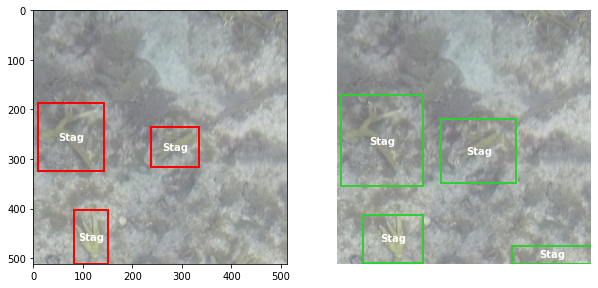

iou  =  0.5049044937080132
staghorn-2-44-18_jpg.rf.3fda5001bd81e49e922d3974be45665b.jpg


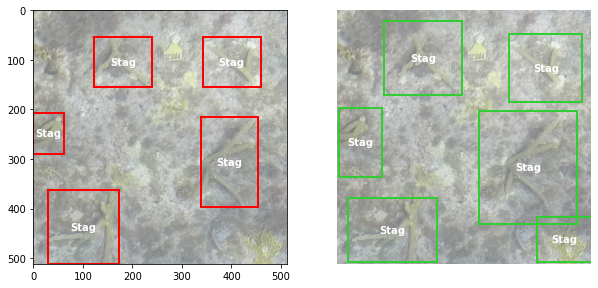

iou  =  0.523267597300695
staghorn-2-45-17_jpg.rf.2bddd414a45cd2ddcf168a85a26d9047.jpg


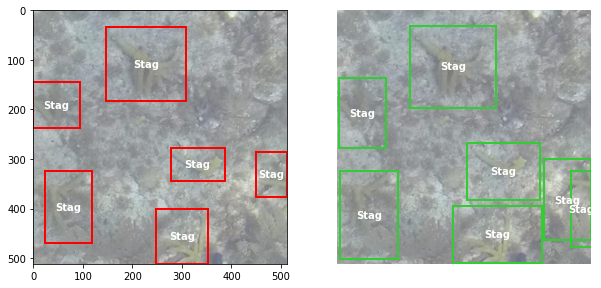

iou  =  0.5661701524042558
staghorn-2-6-40_jpg.rf.898ebfdffeb3105f90b8d68a29b01378.jpg


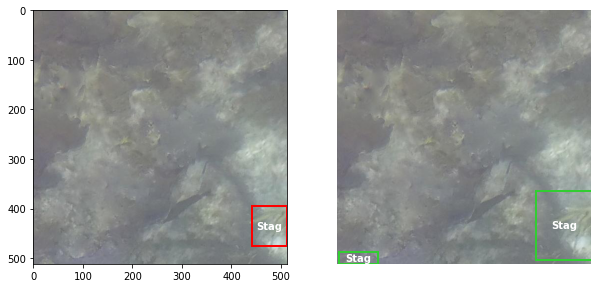

iou  =  0.3633730633913017
staghorn-2-9-39_jpg.rf.bad0fcde52296d0579fd0b76aff1c691.jpg


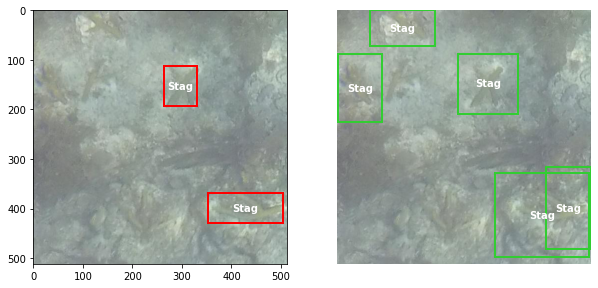

iou  =  0.32617171708029463
staghorn-3-10-7_jpg.rf.81b46187754e6570679201a31385c072.jpg


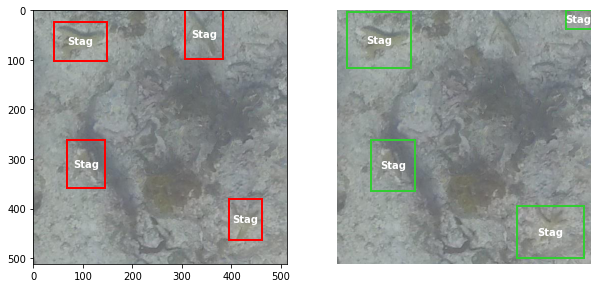

iou  =  0.27974982078803545
staghorn-3-15-11_jpg.rf.c0af3488bc6c3295ad8d9b398d41de25.jpg


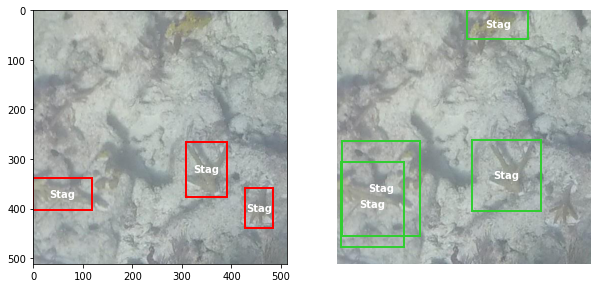

iou  =  0.2563476684664596
staghorn-3-15-12_jpg.rf.c31bfadf4ed7ca506dd2b4e95b520e9d.jpg


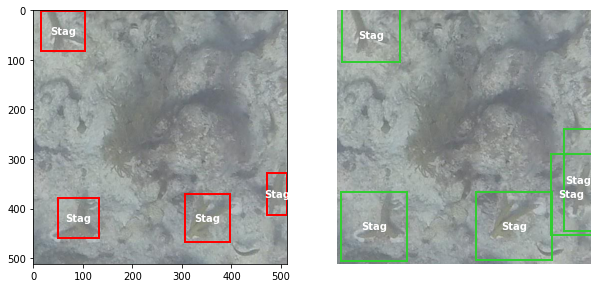

iou  =  0.41098443756870906
staghorn-3-38-7_jpg.rf.68d9cc9d2dc4a0cf8d3a528e859d7a48.jpg


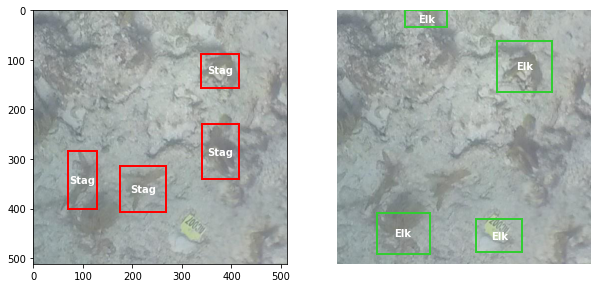

iou  =  0.11498655724160586
staghorn-3-39-7_jpg.rf.0c0a3680083e76b350f0f98e81b42cfd.jpg


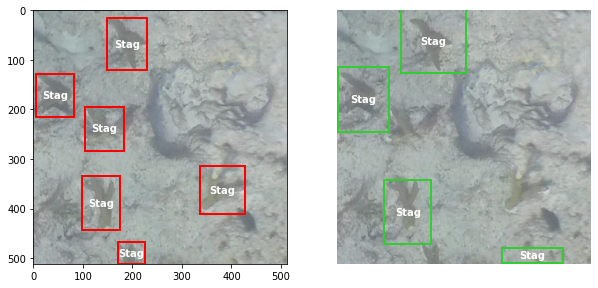

iou  =  0.12054813327757698
staghorn-3-41-8_jpg.rf.a9bd69f03302a5c006759f5c9722e1be.jpg


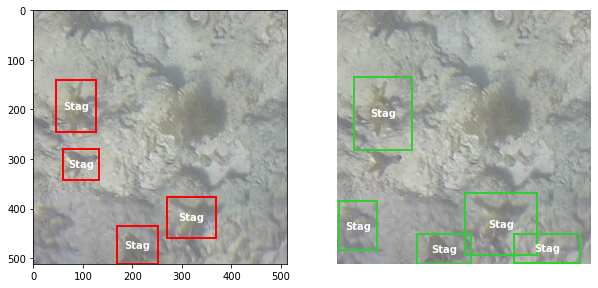

iou  =  0.39285126990750885
staghorn-4-13-21_jpg.rf.af812e23f2c35c5efd9ba555ad5a1063.jpg


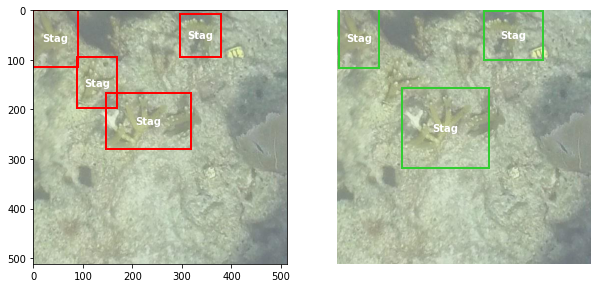

iou  =  0.2190158816290905
staghorn-4-18-27_jpg.rf.f437f3ca41f3a4b993b060fe18721bda.jpg


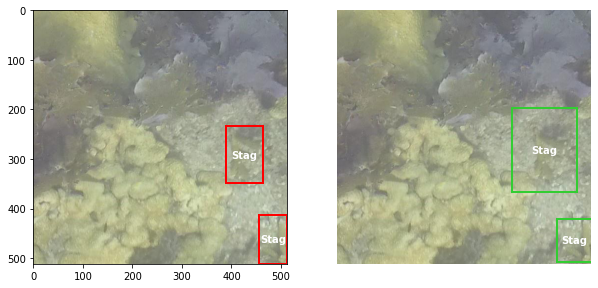

iou  =  0.5363371804743626
staghorn-4-19-28_jpg.rf.c96e8c5bf31a3b8d122ffe9021232f92.jpg


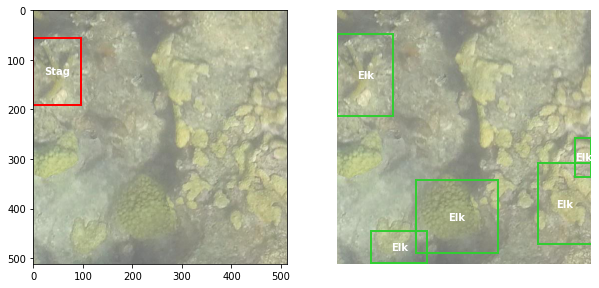

iou  =  0.6857101218261804
staghorn-4-24-25_jpg.rf.33c14254effa1240e0ee7fd1d945b320.jpg


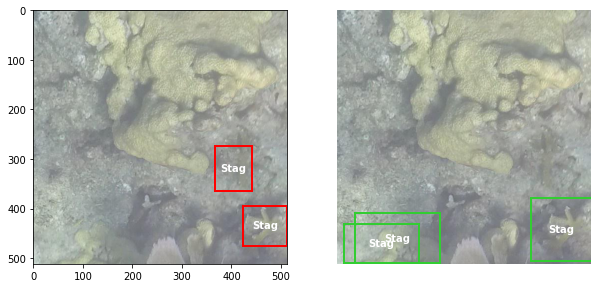

iou  =  0.23069988512258946
staghorn-4-25-24_jpg.rf.5fac9d4a97e2e12da38db97b4d36d642.jpg


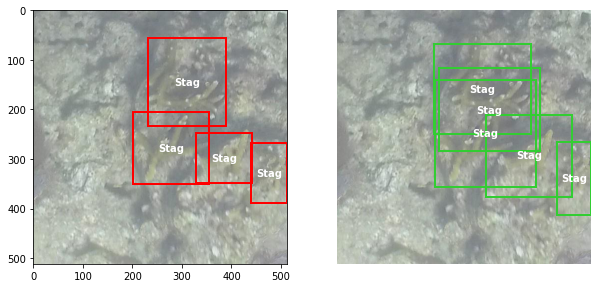

iou  =  0.5921471705974946
staghorn-4-40-24_jpg.rf.97a61e5284dcac2324a7e42195356507.jpg


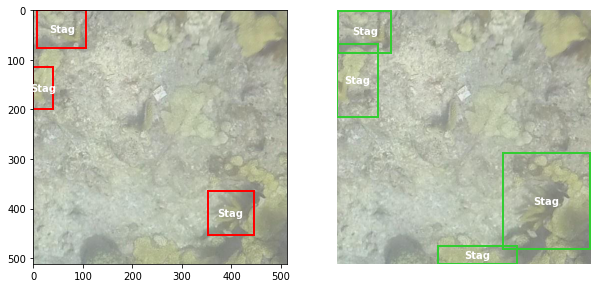

iou  =  0.44561506719228955
staghorn-4-48-17_jpg.rf.9b09d36a0e6d2457c25de60e25a0913e.jpg


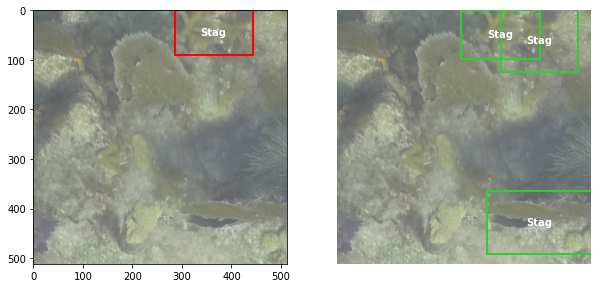

iou  =  0.5825214380825583
staghorn-4-75-13_jpg.rf.e2f2d432eb8c473b1a6b015474609754.jpg


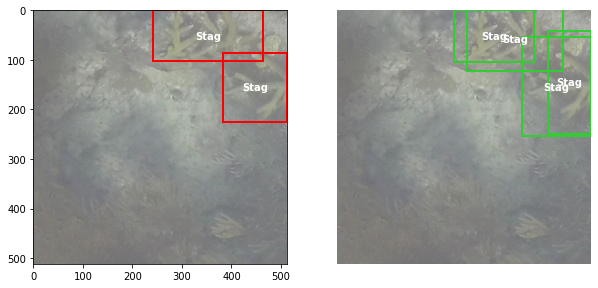

iou  =  0.6959360400141343
staghorn-4-87-10_jpg.rf.27034222a89b0afa3afc189c770ecb6b.jpg


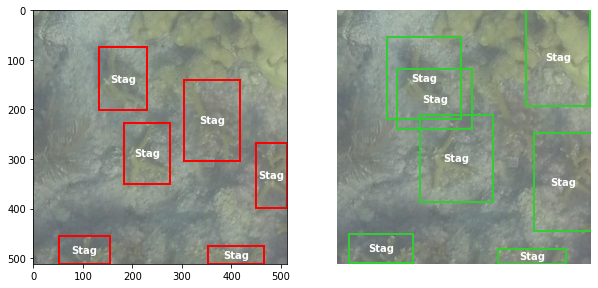

iou  =  0.45083966509592227
staghorn-4-91-11_jpg.rf.5eef6ddd821670cca213303a13050369.jpg


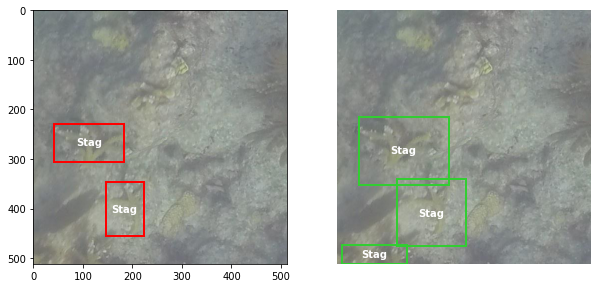

iou  =  0.44058718396824803
staghorn-4-91-8_jpg.rf.3788702d2a704d722ee353ba0ba617c7.jpg


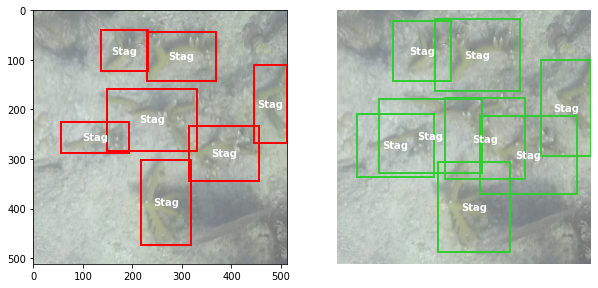

iou  =  0.5053430988265144
staghorn-5-10-13_jpg.rf.8395e5f1e6dcd79f7452840b2c8c3a4a.jpg


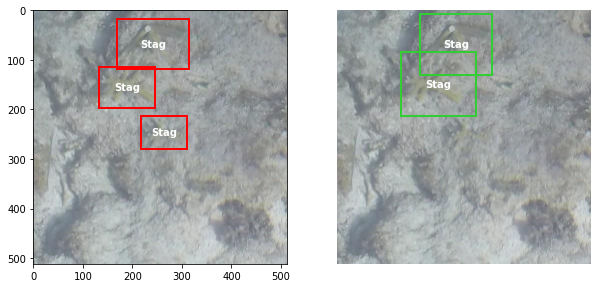

iou  =  0.23710534350213355
staghorn-5-13-12_jpg.rf.3c4a3c7557468b6ddd9c8647c586d1ca.jpg


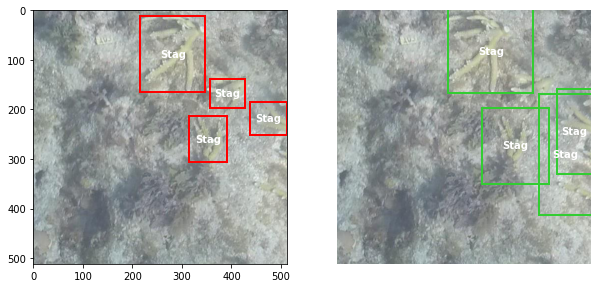

iou  =  0.18862086524548274
staghorn-5-14-19_jpg.rf.00ab483d568296306ec587586f2b23a9.jpg


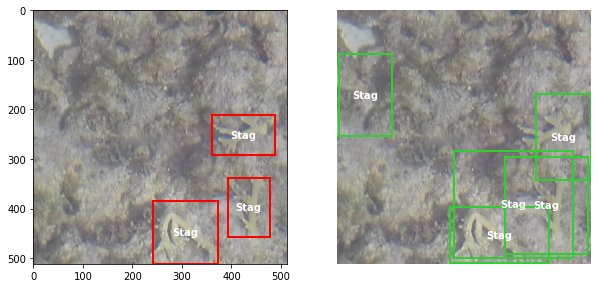

iou  =  0.4103833231831511
staghorn-5-16-15_jpg.rf.75bed4599fa080d5efe28288a83260ec.jpg


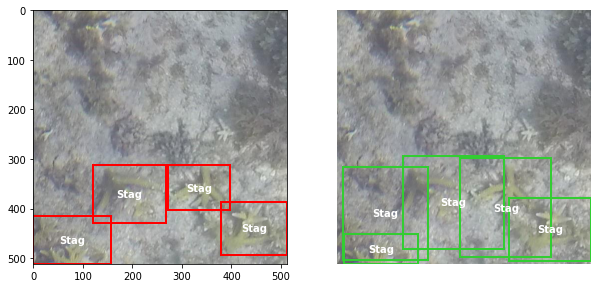

iou  =  0.4817469517701537
staghorn-5-16-18_jpg.rf.d4a83120335cdfe38d23f5f742832119.jpg


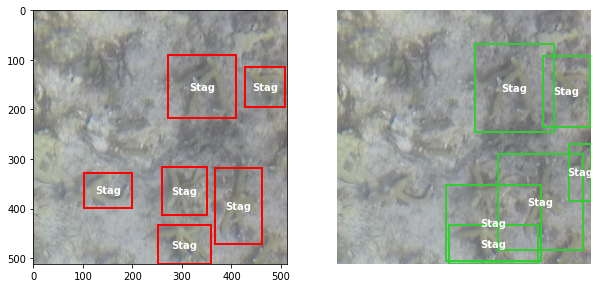

iou  =  0.37828673269722796
staghorn-5-16-5_jpg.rf.e9bc22399d2496f5a830c86cac373650.jpg


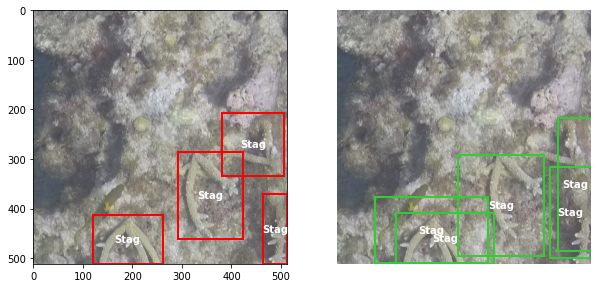

iou  =  0.4700876606312805
staghorn-5-17-9_jpg.rf.65eb796a8694e87d524a24bf9b06afb8.jpg


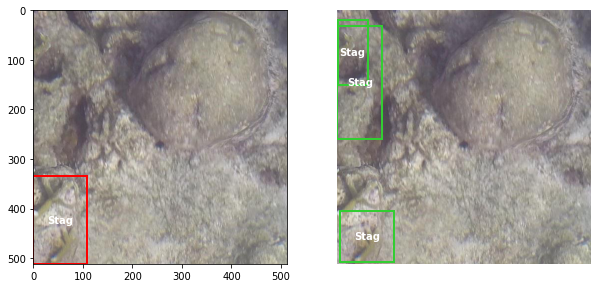

iou  =  0.5387341023727542
staghorn-5-19-9_jpg.rf.c6f7512a6e7b6fa24cdd3c641bb8e9de.jpg


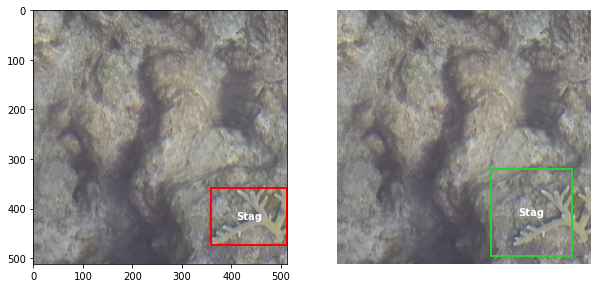

iou  =  0.4000950641538171
staghorn-5-21-10_jpg.rf.59556acf33f9dd1e53f70b6825c9c838.jpg


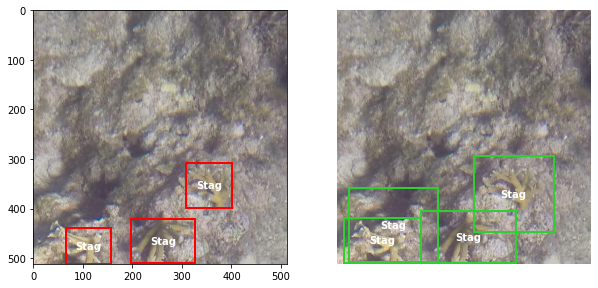

iou  =  0.4496660535577826
staghorn-5-26-14_jpg.rf.4cbce9fc8bd56595b17f69fec87ae9ac.jpg


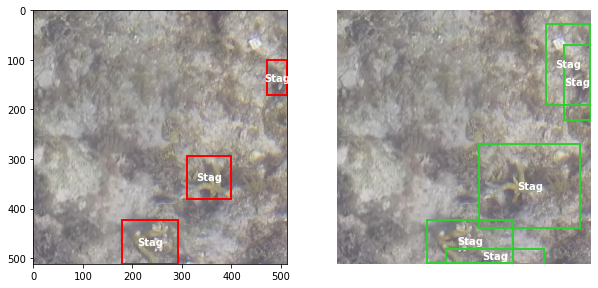

iou  =  0.39773504419332545
staghorn-5-28-8_jpg.rf.f7439a1296cd078f24b47bfc57adb61a.jpg


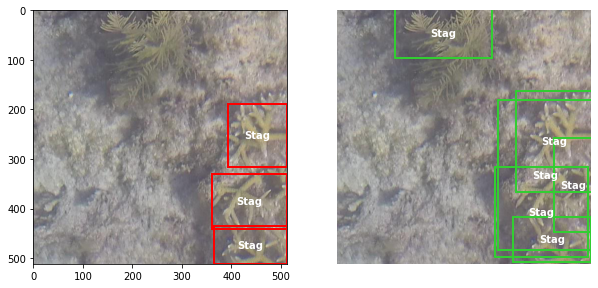

iou  =  0.5574849771568204
staghorn-5-29-11_jpg.rf.f30e1f510e93dcc81862a330636e3ebd.jpg


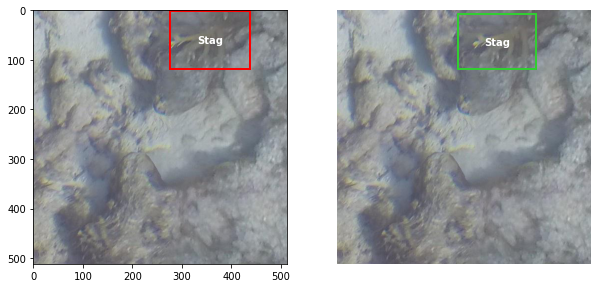

iou  =  0.6100544484435826
staghorn-5-29-9_jpg.rf.0baf8f2dc848e7ec3521a273ead152e8.jpg


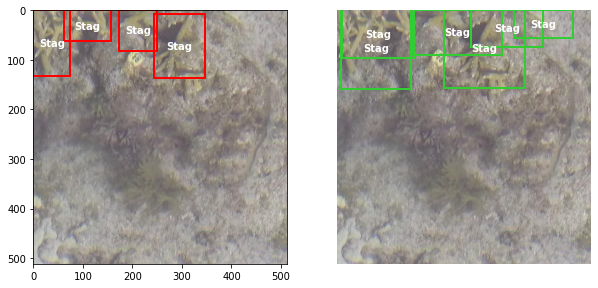

iou  =  0.4127351005085743
staghorn-5-30-15_jpg.rf.1be35cd6c263a56726c03bb18fce5a22.jpg


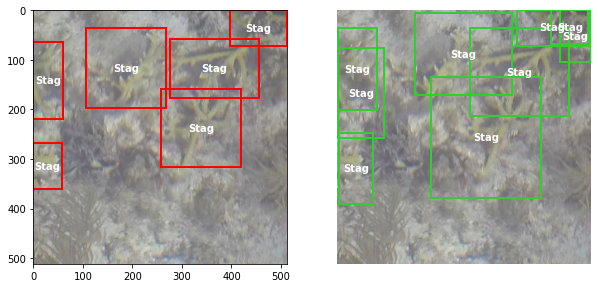

iou  =  0.5266772634373688
staghorn-5-30-20_jpg.rf.55493efcf091a32b1a2809fe65d30bfd.jpg


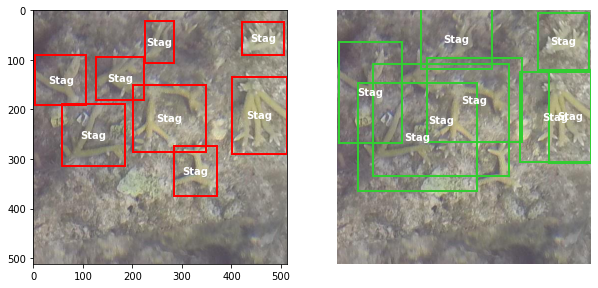

iou  =  0.24219573015881793
staghorn-5-30-21_jpg.rf.767777869d47c1f3598cb7004a71b407.jpg


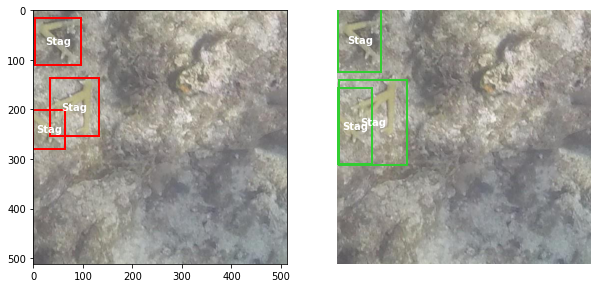

iou  =  0.5392614504549702
staghorn-5-32-16_jpg.rf.4465112c3f8989369d5e1f15bc3cadeb.jpg


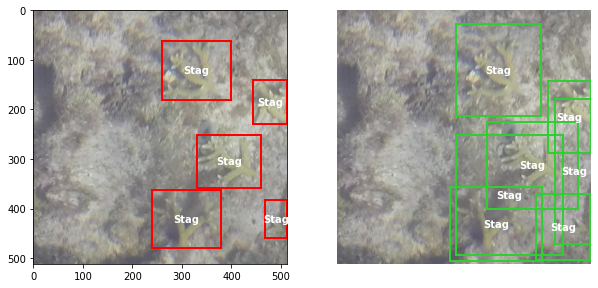

iou  =  0.4419463551105801
staghorn-5-33-14_jpg.rf.c61f8fb6c33bcaa62e324c33091b913f.jpg


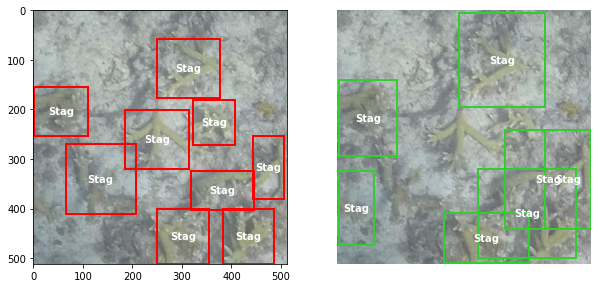

iou  =  0.22118934711181412
staghorn-5-35-15_jpg.rf.7b53ba15932ea78945cafdea18b72bb3.jpg


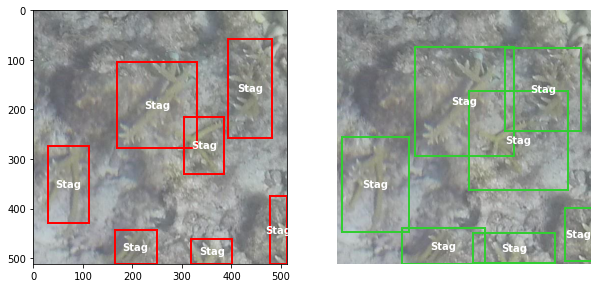

iou  =  0.47499953503273545
staghorn-5-36-14_jpg.rf.cb2707b1c042bf2be944a355eadd4ac4.jpg


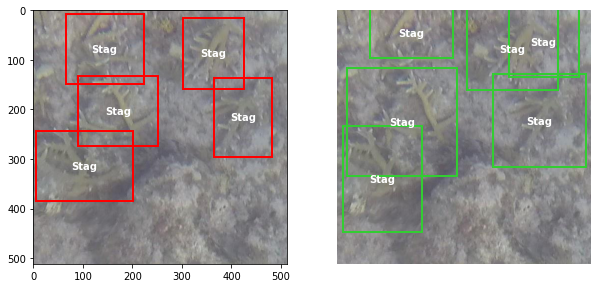

iou  =  0.5337607688512327
staghorn-5-36-23_jpg.rf.2cc3b8f3d56e18c56570b2e0bd6f9205.jpg


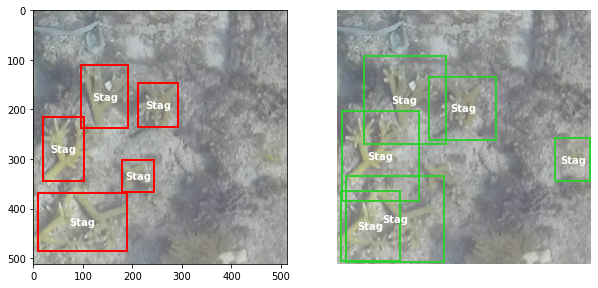

iou  =  0.36321711004363444
staghorn-5-37-23_jpg.rf.dabcf7729cb0a9191e947aab6908dba1.jpg


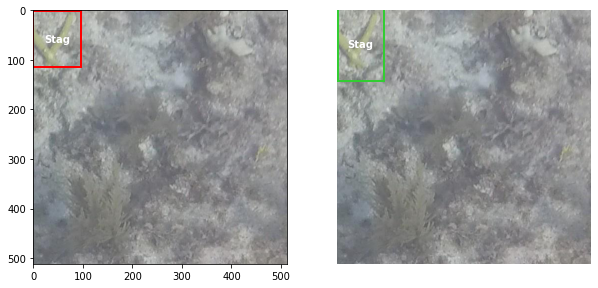

iou  =  0.7343063671889449
staghorn-5-38-23_jpg.rf.7dc43b5f7dbabfa810d694102ca808b6.jpg


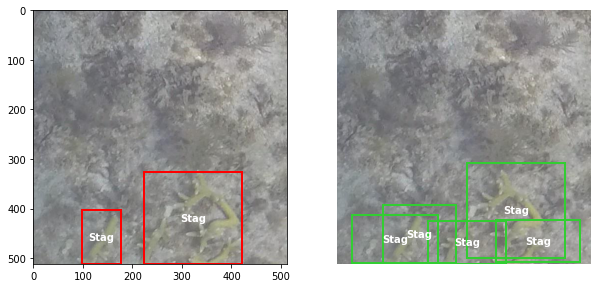

iou  =  0.539186077373855
staghorn-5-39-20_jpg.rf.18418d44c146c44e874d4ecf0ea91b2a.jpg


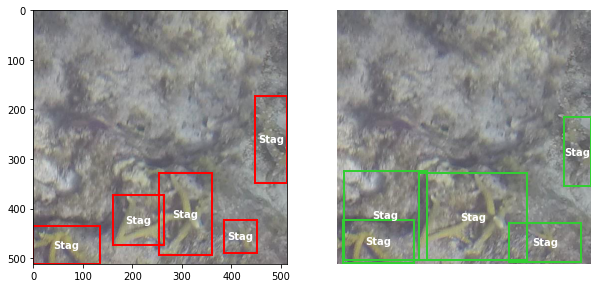

iou  =  0.4343409152707851
staghorn-5-40-21_jpg.rf.ec5ff3f50c409b610fe9aa47ef0425bb.jpg


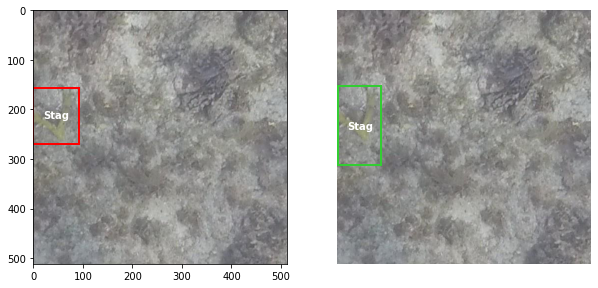

iou  =  0.6795306478516581
staghorn-5-41-19_jpg.rf.03489d911b124feb0c594958218e792a.jpg


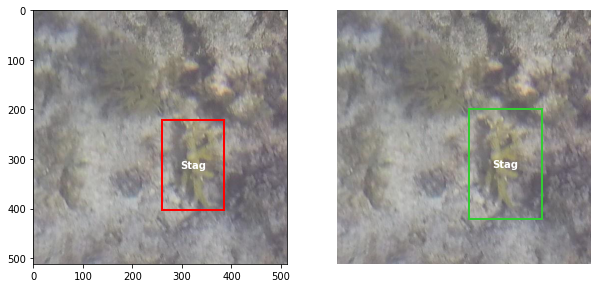

iou  =  0.646853191581106
staghorn-5-41-21_jpg.rf.00144436fd5cd18ac0adb2eee19b5257.jpg


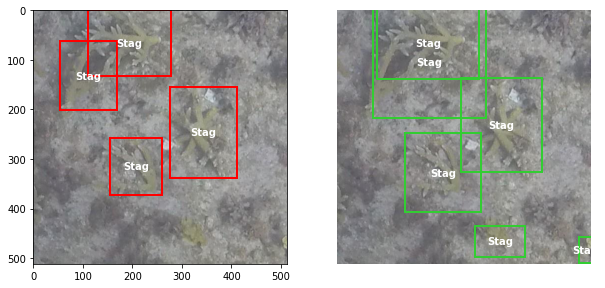

iou  =  0.55455501775896
staghorn-5-44-12_jpg.rf.f03dde5c398bd113a9391384fe1158d8.jpg


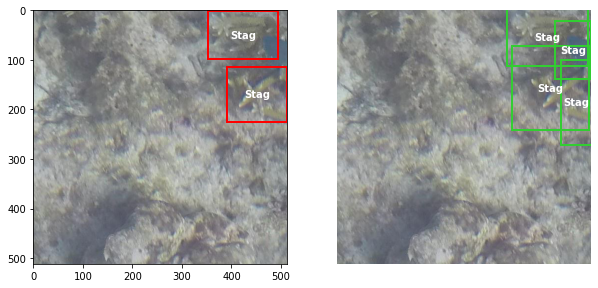

iou  =  0.5932403628245011
staghorn-5-44-19_jpg.rf.e987325d614b79ec491dfbdb1bd0ae83.jpg


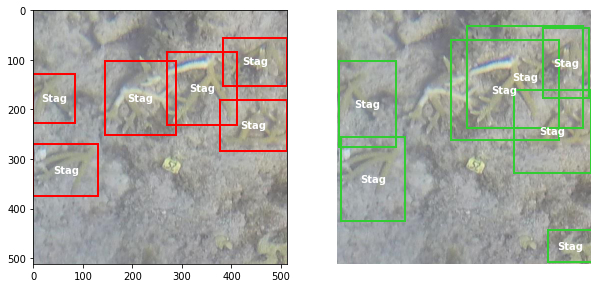

iou  =  0.4320817664960375
staghorn-5-45-20_jpg.rf.7051db43f78ddbc7c8682a00de70027f.jpg


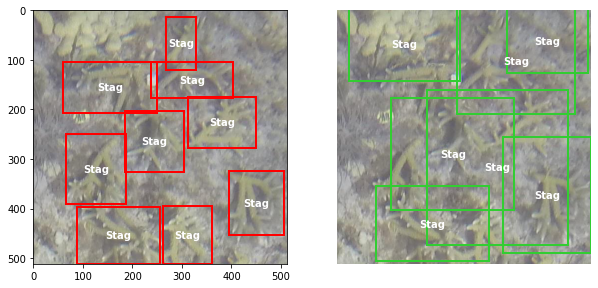

iou  =  0.1772104817257632
staghorn-5-46-18_jpg.rf.615b7c962450160ff6ce79b54f5258cc.jpg


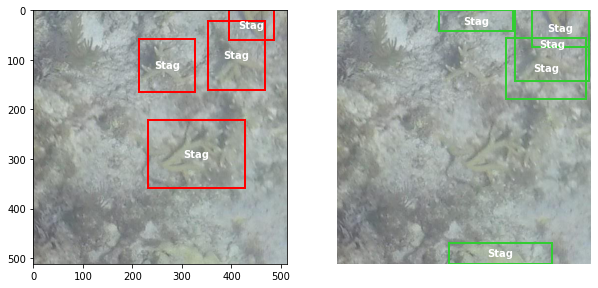

iou  =  0.18739281011560177
staghorn-5-48-17_jpg.rf.73d58883c636aa14763a4efb64aec602.jpg


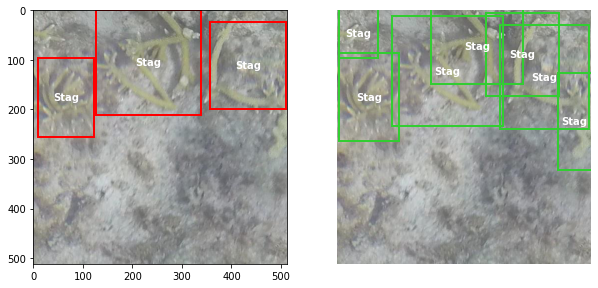

iou  =  0.7550523604401569
staghorn-5-50-25_jpg.rf.6bd61d58f3ef8ce5448b98a9f89b6ccd.jpg


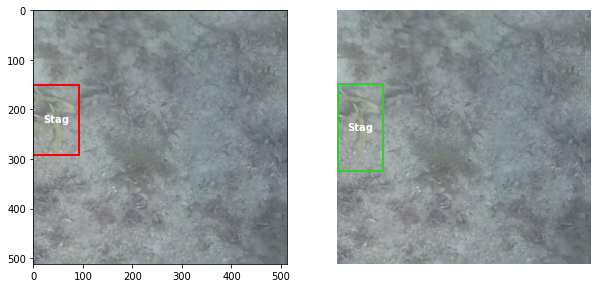

iou  =  0.7914777923785846
staghorn-5-56-18_jpg.rf.73f97ebcef0f8bfe63ee5981b331a00c.jpg


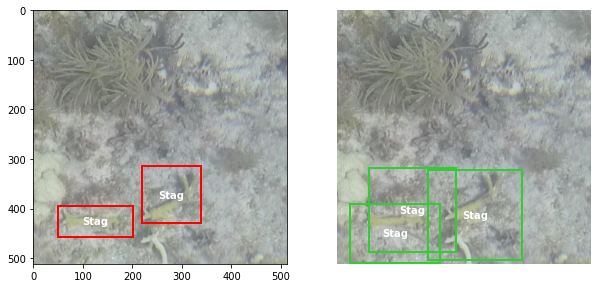

iou  =  0.4022060087732281
staghorn-5-60-16_jpg.rf.aaf4b823e726441ab15d470b30ba11f1.jpg


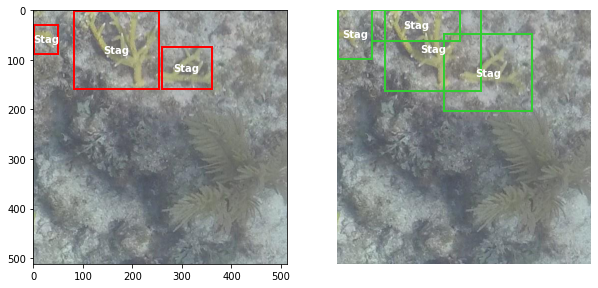

iou  =  0.4738067971561304
staghorn-5-65-22_jpg.rf.494051a6de528e82d442cfd4ef456f88.jpg


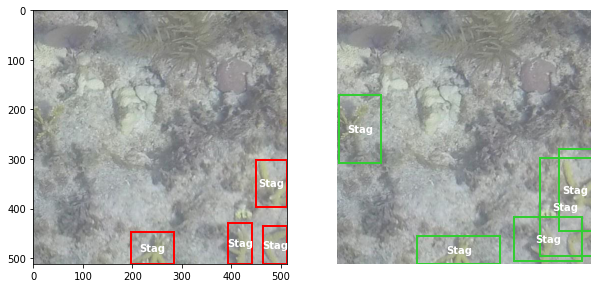

iou  =  0.36706752245332525
staghorn-5-69-19_jpg.rf.7388e4aa58ef1d55a9b51de02769f7bc.jpg


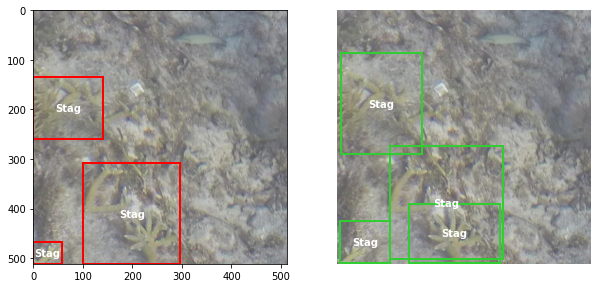

iou  =  0.46995064092128597
staghorn-5-71-17_jpg.rf.04bde07b746aa01d7d2678a4b877aa87.jpg


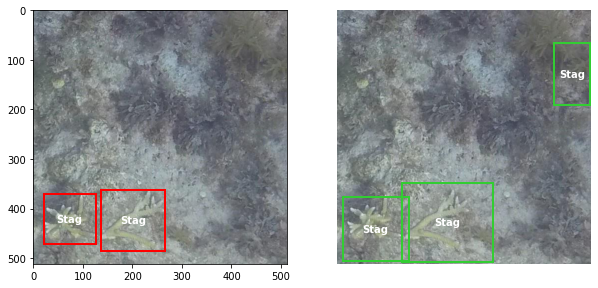

iou  =  0.5494510395328374
staghorn-5-78-30_jpg.rf.14cee018292e3d3f2f36a63fdc811103.jpg


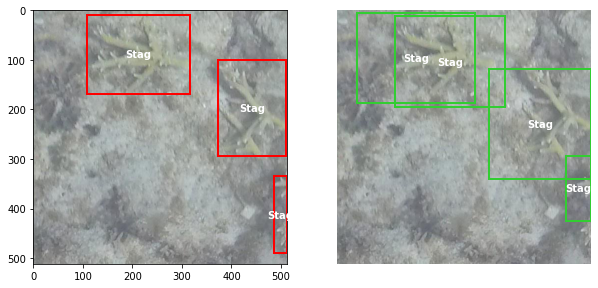

iou  =  0.5093499044314095
staghorn-5-78-31_jpg.rf.68810f1623eaca5917932feaee155439.jpg


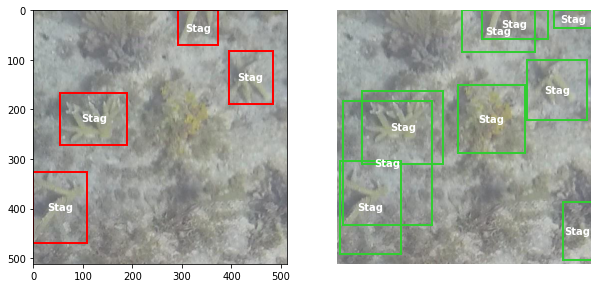

iou  =  0.55307997933185
staghorn-5-78-34_jpg.rf.6d38557f3b3fb30533686ba4a1ddbf0b.jpg


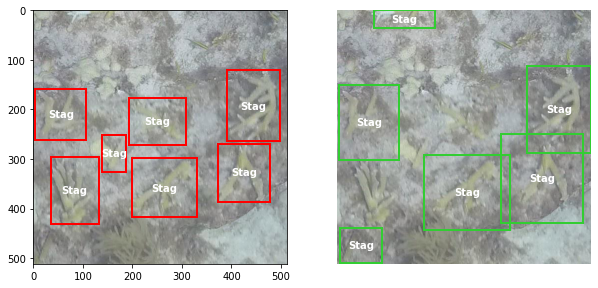

iou  =  0.28195279709648036
staghorn-5-79-28_jpg.rf.4fde82886b816b2f1939258f885b00e8.jpg


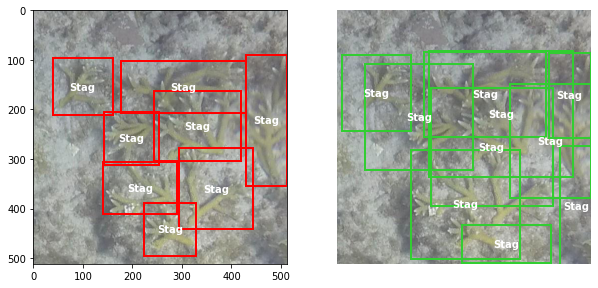

iou  =  0.39403165726600003
staghorn-5-79-29_jpg.rf.90566553b07b1ec0a52e1e322a937058.jpg


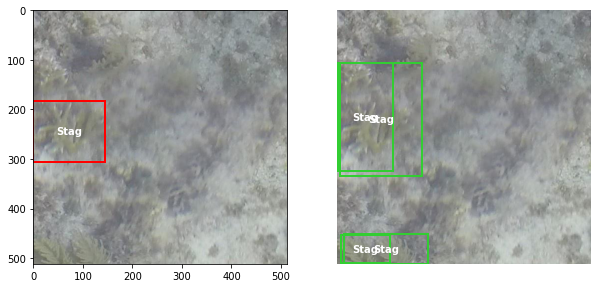

iou  =  0.48992906300995676
staghorn-5-79-30_jpg.rf.b417d7c3c0aa937b377c85bc4f4c3867.jpg


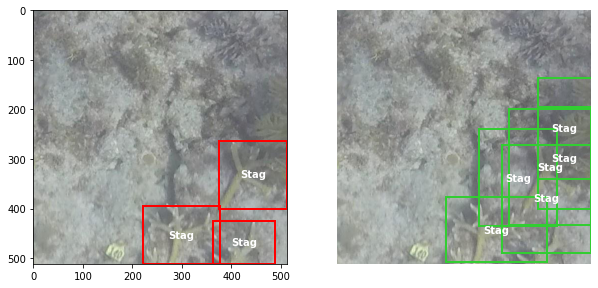

iou  =  0.46433792946340363
staghorn-5-80-38_jpg.rf.81b295f0434d7ffaac59c5c486e617e5.jpg


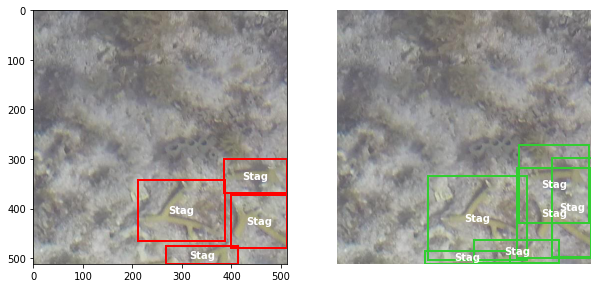

iou  =  0.4970696013662475
staghorn-5-81-42_jpg.rf.e9047d9b1a139e28ed817ec3f3cca860.jpg


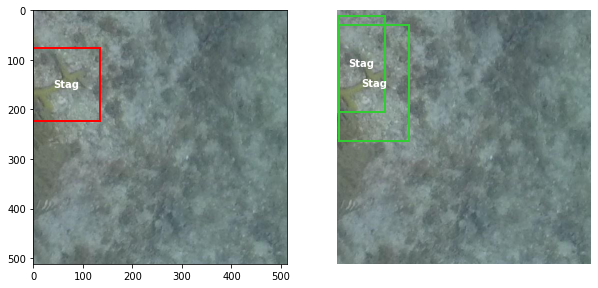

iou  =  0.5774156251290056
staghorn-5-84-34_jpg.rf.e1268e348dd845d588f076afa686a2d8.jpg


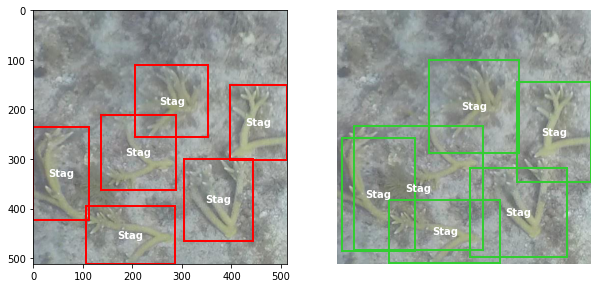

iou  =  0.5327654216261676
staghorn-5-85-23_jpg.rf.f7d521d81d4384c1e7664c247d0af016.jpg


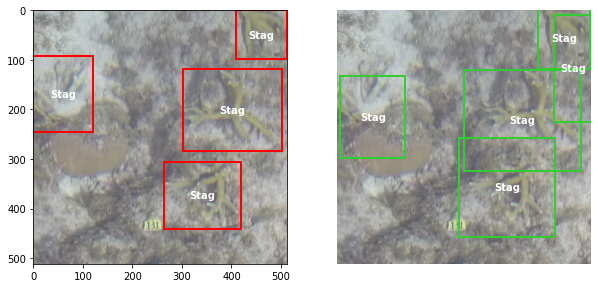

iou  =  0.597591422238571
staghorn-5-85-35_jpg.rf.18cfb3561690b3d879e22677c81eb0e2.jpg


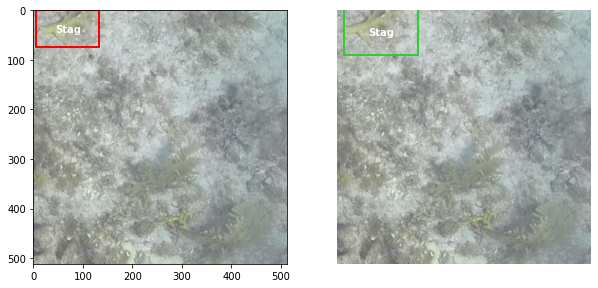

iou  =  0.6159117138902694
staghorn-5-86-36_jpg.rf.72205f7c079f349b588e5ec32d62e29f.jpg


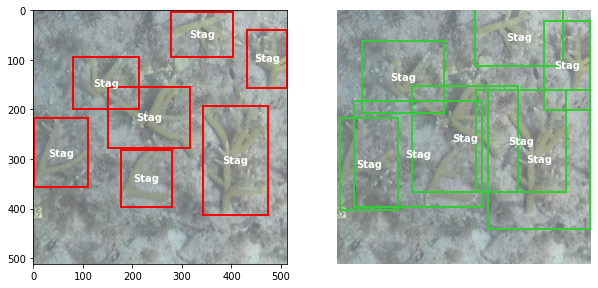

iou  =  0.503519949694935
staghorn-5-87-24_jpg.rf.deb5c6e2a7f185bb44df5a9062f1a612.jpg


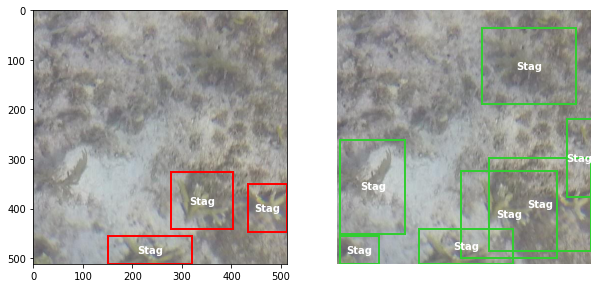

iou  =  0.41338541562328235
staghorn-5-88-20_jpg.rf.2dcdfba886d070452295ffd0a8900515.jpg


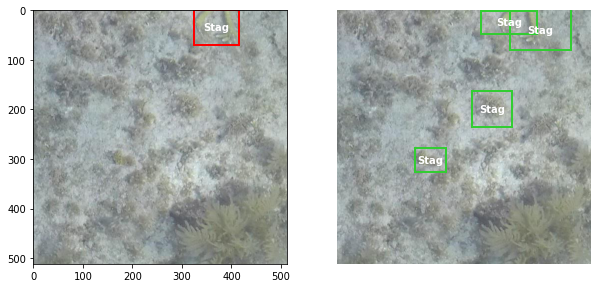

iou  =  0.45881909212583966
staghorn-5-90-34_jpg.rf.f82892a4c89e1f41bf80dc6f435a050c.jpg


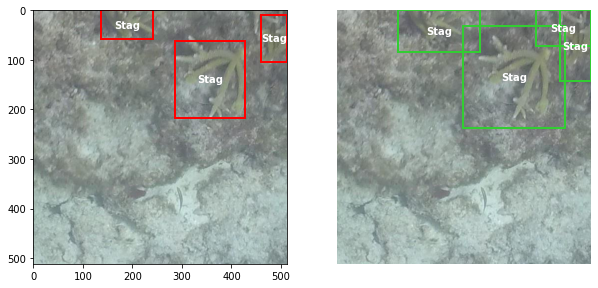

iou  =  0.4989334800611773
staghorn-5-92-37_jpg.rf.fab361c01999cab42365616bdda4e01a.jpg


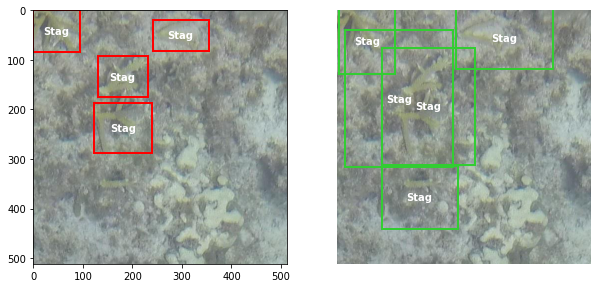

iou  =  0.2893512814922339
staghorn-5-95-26_jpg.rf.a98b5cbae329edbebc8b31d701d61bc4.jpg


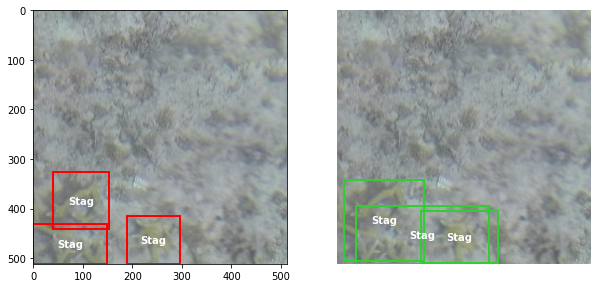

iou  =  0.43226698996210217
IOU =  0.42554064480223625
[146, 151]


In [ ]:



images, targets = [], []

#------------------TESTING DATA-------------------------------
path_images = "/content/gdrive/My Drive/Object_Detection_Transformers/main-repo/dataset/test/images/"
path_annot = "/content/gdrive/My Drive/Object_Detection_Transformers/main-repo/dataset/test/labels/"
path_result = "/content/gdrive/My Drive/Object_Detection_Transformers/main-repo/results/labels/"


# list of paths to images and annotations
image_paths = [
    f for f in os.listdir(path_images) if os.path.isfile(os.path.join(path_images, f))
]
annot_paths = [
    f for f in os.listdir(path_annot) if os.path.isfile(os.path.join(path_annot, f))
]
image_result = [
    f for f in os.listdir(path_result) if os.path.isfile(os.path.join(path_result, f))
]
image_size = 512  

image_paths.sort()
annot_paths.sort()
image_result.sort()
horn={'0':"Elk",'1':"Stag"}
total = 0
misclassified = 0
idx=[]
for i in range(0 , 215): #[146, 151] 
    print(image_paths[i])
    
    image = keras.utils.load_img(
        path_images + image_paths[i],
    )
    (w, h) = image.size[:2]
    # resize train set images
    #if i < int(len(annot_paths) * 0.8):
        # resize image if it is for training datase t
    image = image.resize((image_size, image_size))
    
    # convert image to array and append to list
    images.append(keras.utils.img_to_array(image))
    
    # plt.figure(figsize=(15, 5))
    # plt.subplot(1, 2, 1)
    # plt.imshow(image)
    # plt.title(' test image')
    # plt.axis("off")
    fig, (ax1,ax2) = plt.subplots(1, 2, figsize=(10, 10))
    plt.axis('off')

    # Display the image
    ax1.imshow(image)
   
    f = open(path_annot +  image_paths[i][:-3]+"txt", "r")
    line = f.readline()
    coral_type = ""
    box_gt = []
    while line:
       coordinates = line.split()
       line = f.readline()
       x_center, y_center ,box_width, box_height  = float(coordinates[1]) , float(coordinates[2]) , float(coordinates[3]) , float(coordinates[4] )
       top_left_x = x_center - box_width / 2 
       top_left_y = y_center - box_height / 2
       bottom_right_x = x_center + box_width / 2 
       bottom_right_y = y_center + box_height / 2  
 
       #print(top_left_x * image_size , top_left_y * image_size,bottom_right_x * image_size, bottom_right_y * image_size)

       box = [top_left_x * image_size , top_left_y * image_size,bottom_right_x * image_size, bottom_right_y * image_size]
       box_gt.append(box)        
        # Create the bounding box
        
       rect = patches.Rectangle(
          (top_left_x * image_size, top_left_y * image_size),
          (bottom_right_x - top_left_x) * image_size,
          (bottom_right_y - top_left_y) * image_size,
          facecolor="none",
          edgecolor="red",
          linewidth=2,
          label='Label',
        )
       ax1.add_patch(rect)
       x= (top_left_x * image_size)+(bottom_right_x - top_left_x) * image_size/2
       y= (top_left_y * image_size)+(bottom_right_y - top_left_y) * image_size/2
       ax1.annotate(horn[coordinates[0]], (x, y), color='white', weight='bold', fontsize=10, ha='center', va='center')
       coral_type = coordinates[0]
       #plt.add_patch(rect)
    f.close()

    if(coral_type == ""):
      total = total + 1
      continue

    image1 = keras.utils.load_img(
        path_images + image_paths[i],
    )
    
    f = open(path_result +  image_paths[i][:-3]+"txt", "r")
    line = f.readline()
    boxes = []
    while line:
       coordinates = line.split()
       line = f.readline()
       x_center, y_center ,box_width, box_height  = float(coordinates[1]) , float(coordinates[2]) , float(coordinates[3]) , float(coordinates[4] )
       top_left_x = x_center - box_width / 2 
       top_left_y = y_center - box_height / 2
       bottom_right_x = x_center + box_width / 2 
       bottom_right_y = y_center + box_height / 2  
 
       box = [top_left_x * image_size , top_left_y * image_size,bottom_right_x * image_size, bottom_right_y * image_size]
       boxes.append(box)
    f.close()
        # Create the bounding box
    unique_boxes = get_unique_boxes(boxes)
    for box in unique_boxes:
       top_left_x  , top_left_y  , bottom_right_x , bottom_right_y  = box[0] , box[1] , box[2] , box[3]
       rect = patches.Rectangle(
          (top_left_x , top_left_y ),
          (bottom_right_x - top_left_x) ,
          (bottom_right_y - top_left_y) ,
          facecolor="none",
          edgecolor="limegreen",
          linewidth=2,
          label='Label',
        )
       ax2.add_patch(rect)
       x= (top_left_x ) + (bottom_right_x - top_left_x) * 1/2
       y= (top_left_y )+(bottom_right_y - top_left_y) * 1/2
       ax2.annotate(horn[str(int(float(coordinates[0])))], (x, y), color='white', weight='bold', fontsize=10, ha='center', va='center')
    if( int(coral_type) != int(float(coordinates[0]))):
      idx.append(i)
      misclassified = misclassified + 1

    ax2.imshow(image1)
    plt.show()
    iou = calculate_iou(box_gt, unique_boxes)
    print("iou" , " = " , iou)
    total = total + iou
    # Add the bounding box to the image
print("IOU = " , total / 215)  
print(idx)